In [4]:
#for reading files
import glob
import tifffile

#math computation and data organization
import numpy as np
import math
import scipy
from scipy.ndimage import binary_erosion, binary_fill_holes
from scipy import optimize
from scipy.optimize import curve_fit
import pandas as pd

# For loading bars
from tqdm.notebook import tqdm as tqdm

#For image plotting
import skimage.io
from skimage import restoration

#For identifying aster center
from skimage.filters import threshold_otsu, gaussian, threshold_mean
from skimage.measure import regionprops
import cv2

#for fitting
from lmfit import minimize, Parameters, fit_report

#for image registration
from skimage.registration import phase_cross_correlation
import os

#Matplotlib plotting packages
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize
import matplotlib.colors as mcolors
import matplotlib.cm as cm
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib import patches
from matplotlib import gridspec

import seaborn as sns
sns.set_context("poster")
sns.set_style("ticks")

#Movie
import celluloid as cell
import matplotlib.animation as animation

#for saving data
import csv
import h5py

#for abel transform
import abel

# #custom analysis packages
# import aster_packages as ap #### commented out 20241114 since lucida fonts are not installed...

# Thing to enable lovely parallelization
import concurrent.futures

# Enable repeat from itertools for parallel
import itertools

#time elements for testing runtimes and using todays date
import time
from datetime import datetime

In [1]:
######### gabe hacky styling to emulate some of PBoC Phillips lab style conventions, however hacky. tries to make easier for nigel++
## Styling
import matplotlib
import matplotlib.ticker as ticker
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_context("poster")
# sns.set_style('ticks')

import matplotlib.colors as mcolors
from mpl_toolkits.axes_grid1 import make_axes_locatable

# Set the property to save figures with text as text, not paths
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42

# default good PBoC colors
baseBlendColor=(224/255, 219/255, 209/255,1) # default background for plots
contrastColor=(209/255, 193/255, 171/255,1) # slightly darker tan for contrasts, e.g. in inset boxes
yellowTanHighlightBoxColor='#FEF0C6'
goodGreyGreenArrowColor='#CCD4C9'

### Griffin style invocation

from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib.path import Path
from matplotlib.patches import BoxStyle
from matplotlib.offsetbox import AnchoredText

def plotting_style(grid=False):
    """
    Sets the style to the publication style. To instantiate, simply call
    plotting_style() at the beginning of your script or notebook to force
    all matplotlib plots to adopt the scheme.

    Parameters
    ----------
    grid: bool
      If True, plots will have a thin, white grid in the background. Default
      is False.

    Returns
    -------
    colors: dict
      Returns a dictionary of the standard PBoC 2e color palette.
    """
    rc = {'axes.facecolor': '#E3DCD0',
#               'axes.spines.top': False,
#               'axes.spines.right': False,
#               'axes.spines.left': False,  # Ensure left spine is present
#               'axes.spines.bottom': False,  # Ensure bottom spine is present
#               'axes.spines.left': False, #{'color': '#E3DCD0', 'linewidth': 1.5},  # Set the spine color to the background color
#               'axes.spines.bottom': False, #{'color': '#E3DCD0', 'linewidth': 1.5},  # Set the spine color to the background color
          #'font.family': '/usr/share/fonts/truetype/LucidaSansOT.otf', #'LucidaSansOT.otf',
          'grid.linestyle': '-',
          'grid.linewidth': 0.5,
          'grid.alpha': 0.75,
          'grid.color': '#ffffff',
          'axes.grid': grid,
          'ytick.direction': 'in',
          'xtick.direction': 'in',
          'xtick.gridOn': grid,
          'ytick.gridOn': grid,
#               'ytick.major.width':8,
#               'xtick.major.width':8,
#               'ytick.major.size': 8,
#               'xtick.major.size': 8,
          'mathtext.fontset': 'stixsans',
          'mathtext.sf': 'sans',
          'legend.frameon': True,
          'legend.facecolor': '#FFEDCE',
          'figure.dpi': 150,
          'xtick.color': 'k',
          'ytick.color': 'k'
         }
    plt.rc('text.latex', preamble=r'\usepackage{sfmath}')
    plt.rc('mathtext', fontset='stixsans', sf='sans')
    sns.set_style('darkgrid', rc=rc)
    return color_palette()

def color_palette():
    """
    Returns a dictionary of the PBOC color palette
    """
    return {'green': '#7AA974', 'light_green': '#BFD598',
              'pale_green': '#DCECCB', 'yellow': '#EAC264',
              'light_yellow': '#F3DAA9', 'pale_yellow': '#FFEDCE',
              'blue': '#738FC1', 'light_blue': '#A9BFE3',
              'pale_blue': '#C9D7EE', 'red': '#D56C55', 'light_red': '#E8B19D',
              'pale_red': '#F1D4C9', 'purple': '#AB85AC',
              'light_purple': '#D4C2D9', 'dark_green':'#7E9D90', 'dark_brown':'#905426'}

def titlebox(
    ax, text, color, bgcolor=None, size=8, boxsize=0.1, pad=0.05, **kwargs
):
    """
    Sets a colored title box above the plot, spanning the entire plot width.

    Parameters
    ----------
    ax : matplotlib axis object
      The axis on which you want to add the titlebox.
    text: str
      The title tect
    bgcolor: str or None
      The background color of the title box. Default is no color (blank).
    size:  int
      Size of the text font
    boxsize: float [0, 1]
      Fraction of the total plot height to be occupied by the box. Default is 10% (0.1).
    pad: float
      The padding space between the title box and the top of the plot.

    """
    boxsize=str(boxsize * 100)  + '%'
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("top", size=boxsize, pad=pad)
    cax.get_xaxis().set_visible(False)
    cax.get_yaxis().set_visible(False)
    cax.spines["top"].set_visible(False)
    cax.spines["right"].set_visible(False)
#     cax.spines["bottom"].set_visible(False)
#     cax.spines["left"].set_visible(False)

#     cax.spines["bottom"].set_visible(True)
#     cax.spines["left"].set_visible(True)
#     cax.spines["left"].set_color("white")
#     cax.spines["bottom"].set_color("white")
#     cax.spines["bottom"].set_color("white")

#     cax.set_ticks_position('both')  # Adding ticks to both top and bottom
#     cax.yaxis.set_tick_params(direction='in', which='both', color='white')  # The bottom will maintain the default of 'out'


    plt.setp(cax.spines.values(), color=color)
    if bgcolor != None:
        cax.set_facecolor(bgcolor)
    else:
        cax.set_facecolor("white")
    at = AnchoredText(text, loc=10, frameon=False, prop=dict(size=size, color=color))
    cax.add_artist(at)


### Now actually call it
plotting_style()

import matplotlib.patheffects as pe
matplotlib.rcParams['axes.autolimit_mode'] = 'data'

# Relevant Functions

In [158]:
def parse_ome(file, channel_list=['YFP', 'MT']):
    """
    Extracts image arrays from an ome.tif file.
    
    Parameters:
    file (string): Data file path.
    channel_list (list of strings): Names of fluorescent channels taken in this dataset
    
    Returns:
    (list): List of images (as 3D numpy.ndarrays) for each fluorescent channel with shape (# images, m, n).
    """
    
    images = []
    # Open and read the OME-TIFF file
    with tifffile.TiffFile(file) as tif:

        for i, page in enumerate(tif.pages):
            image_data = page.asarray()
            images.append(image_data)

        # Access the OME metadata if needed
        ome_metadata = tif.ome_metadata

    print(len(images))
    
    ch1 = images[0::2]
    ch2 = images[1::2]
    
    return [np.array(ch1), np.array(ch2)]

In [248]:
### hackish binning alternative
## assume square
def cartesianToPolar(image):
    """ Assumes image is a m x m (square, 2d) array, and the origin is the closest-to-central pixel.
        Returns:
            list of all r values of each pixel
    """
    
    m = image.shape[0]
    center = (m // 2, m // 2)
    
    # Create grid of coordinates
    y, x = np.indices((m, m))
    x = x - center[1]
    y = y - center[0]
    
    # Convert to polar coordinates
    r = np.sqrt(x**2 + y**2)
    theta = np.arctan2(y, x)
    
    return r, theta

def polarAverage(image, bins=20, rTraceMode=np.nanmean):
    r, theta = cartesianToPolar(image)
    
    if type(bins)==int:
        # if just an integer, automatically find the radial bins
        max_radius = np.max(r)
        radial_bins = np.linspace(0, max_radius, bins)
        radial_profile = np.zeros(bins - 1) #preallocate
    
    else:
        # else, if bins is an array, assume that the bin edges are supplied explicitly.
        radial_bins=bins;
        radial_profile = np.zeros(bins.shape[0] - 1)
    
    for i in range(len(radial_bins) - 1):
        mask = (r >= radial_bins[i]) & (r < radial_bins[i + 1])
        radial_profile[i] = rTraceMode(image[mask])
    
    return (radial_bins[:-1]+radial_bins[1:])/2, radial_profile # this returns the MIDPOINT of the radii defining the annuli bins

def getSensibleBins(image, numBins=15):
    rmax=image.shape[0]//2
    return np.linspace(0, rmax, numBins)

In [159]:
#for sure raw
rawIms = parse_ome('../../data/aster/zstacks/2022-Nov-07_YFP-Ncd_R1_Zstack_2/2022-Nov-07_YFP-Ncd_R1_Zstack_2_MMStack_Pos0.ome.tif', channel_list=['YFP', 'MT'])


322


# Import

In [321]:
# read in tif stacks
fpath = '../../data/aster/zstacks/Decovolution/Nov7_2022/'
motStack = tifffile.imread(fpath+'MotorStack.tif')
psfStack = tifffile.imread(fpath+'PSF BW.tif')
#deconvolved im
deconvIms = tifffile.imread('../../data/aster/zstacks/Decovolution/Nov7_2022/RL1000.tif')

# read in tif stacks from nov2
fpathnov2 = '../../data/aster/zstacks/Decovolution/Nov2_2022/'
motStacknov2 = tifffile.imread(fpathnov2+'2022-Nov-02_YFP-Ncd_R5_NextDayZstack_4_MMStack_Pos0.ome.tif')
psfStacknov2 = tifffile.imread(fpathnov2+'PSF BW.tif')
deconvnov2 = tifffile.imread(fpathnov2+'Final Display of RL.tif')

#for sure raw
rawIms = parse_ome('../../data/aster/zstacks/2022-Nov-07_YFP-Ncd_R1_Zstack_2/2022-Nov-07_YFP-Ncd_R1_Zstack_2_MMStack_Pos0.ome.tif', channel_list=['YFP', 'MT'])
#split channels
rawIms_mot = tifffile.imread('../../data/aster/zstacks/ADGSedits/C1-2022-Nov-07_YFP-Ncd_R1_Zstack_2_MMStack_Pos0.ome.tif')
rawIms_mt = tifffile.imread('../../data/aster/zstacks/ADGSedits/C2-2022-Nov-07_YFP-Ncd_R1_Zstack_2_MMStack_Pos0.ome.tif')

#RL 2D plane
twoDRL = tifffile.imread('../../data/aster/zstacks/Decovolution/Nov7_2022/substacks/RL1000_2Dframe60.tif')


#image dimentions listed in voxel size in "show info" part of fiji
umperpxXY = 296.14/512
umperpxZ = 60/120
xyext = (-motStack.shape[1]//2*umperpxXY, motStack.shape[1]//2*umperpxXY, -motStack.shape[2]//2*umperpxXY, motStack.shape[2]//2*umperpxXY)
xzext = (-motStack.shape[1]//2*umperpxXY, motStack.shape[1]//2*umperpxXY, -motStack.shape[0]//2*umperpxZ, motStack.shape[0]//2*umperpxZ)

322


# Raw from ome.tiff

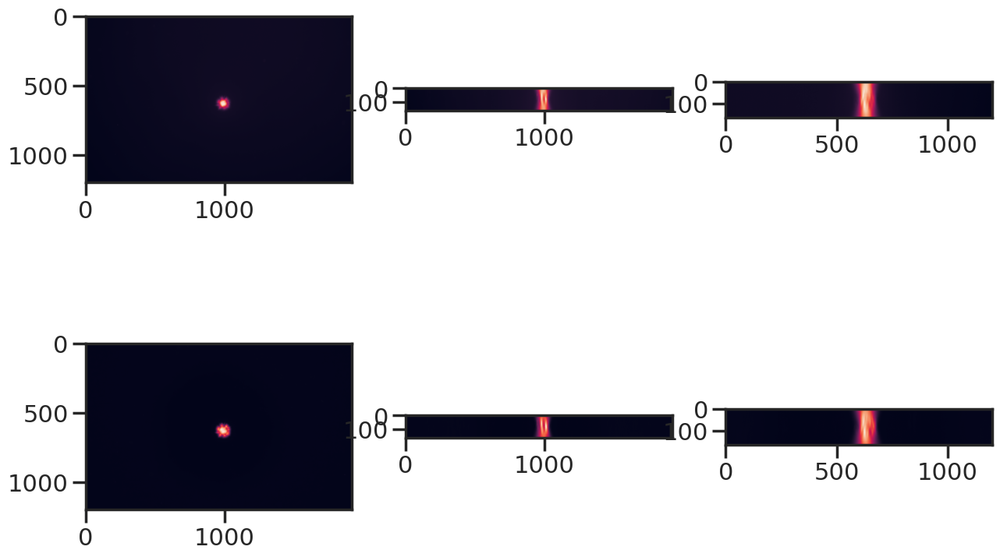

In [174]:
fig, ax=plt.subplots(2, 3, figsize=(15,10))
ax[0,0].imshow(rawIms_mot[rawIms_mot.shape[0]//2])
ax[0,1].imshow(rawIms_mot[:, rawIms_mot.shape[1]//2, :])
ax[0,2].imshow(rawIms_mot[:, :, rawIms_mot.shape[2]//2])

ax[1,0].imshow(rawIms_mt[rawIms_mt.shape[0]//2])
ax[1,1].imshow(rawIms_mt[:, rawIms_mt.shape[1]//2, :])
ax[1,2].imshow(rawIms_mt[:, :, rawIms_mt.shape[2]//2])

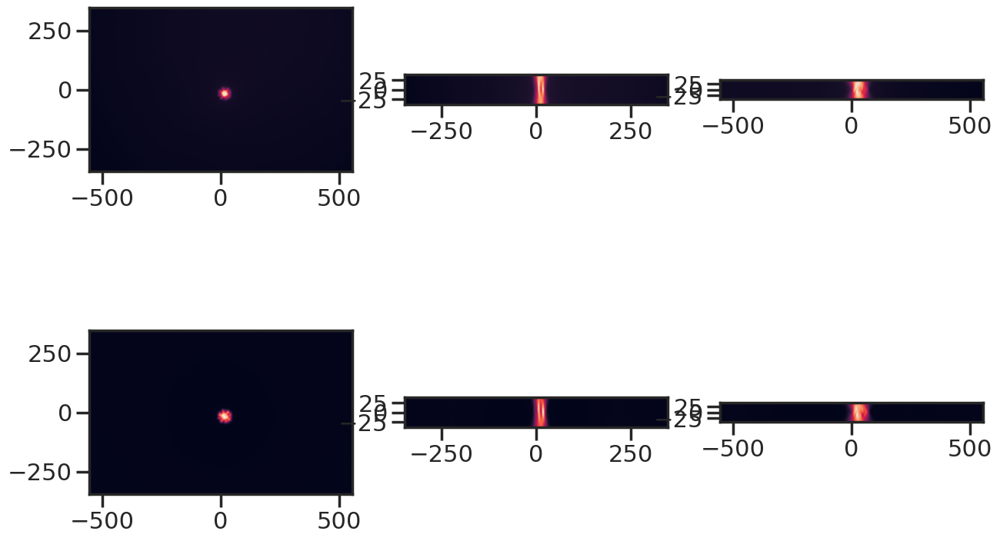

In [177]:
#image dimentions listed in voxel size in "show info" part of fiji
umperpxXY = 296.14/512
umperpxZ = 60/120
xyextraw = (-rawIms_mot.shape[2]//2*umperpxXY, rawIms_mot.shape[2]//2*umperpxXY, -rawIms_mot.shape[1]//2*umperpxXY, rawIms_mot.shape[1]//2*umperpxXY)
yzextraw = (-rawIms_mot.shape[1]//2*umperpxXY, rawIms_mot.shape[1]//2*umperpxXY, -rawIms_mot.shape[0]//2*umperpxZ, rawIms_mot.shape[0]//2*umperpxZ)
xzextraw = (-rawIms_mot.shape[2]//2*umperpxXY, rawIms_mot.shape[2]//2*umperpxXY, -rawIms_mot.shape[0]//2*umperpxZ, rawIms_mot.shape[0]//2*umperpxZ)


fig, ax=plt.subplots(2, 3, figsize=(15,10))
ax[0,0].imshow(rawIms_mot[rawIms_mot.shape[0]//2], extent = xyextraw)
ax[0,1].imshow(rawIms_mot[:, rawIms_mot.shape[1]//2, :], extent=yzextraw)
ax[0,2].imshow(rawIms_mot[:, :, rawIms_mot.shape[2]//2], extent=xzextraw)

ax[1,0].imshow(rawIms_mt[rawIms_mt.shape[0]//2], extent = xyextraw)
ax[1,1].imshow(rawIms_mt[:, rawIms_mt.shape[1]//2, :], extent=yzextraw)
ax[1,2].imshow(rawIms_mt[:, :, rawIms_mt.shape[2]//2], extent=xzextraw)

# Nov 2 aster

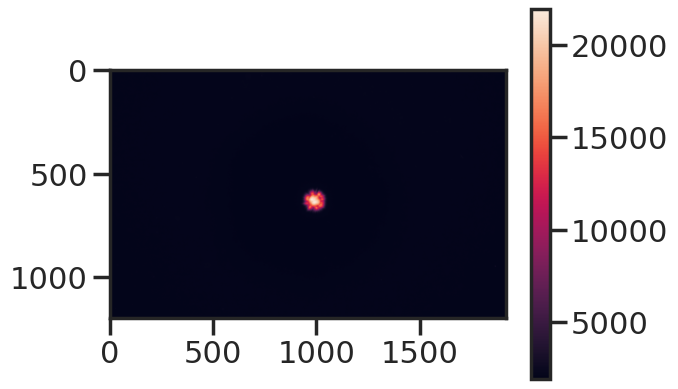

In [203]:
plt.imshow(rawIms_mt[rawIms_mot.shape[0]//2])
#plt.scatter(993,630, s=1)
plt.colorbar()

In [206]:
rawIms_mot.shape[0]//2

80

In [209]:
zl

20

In [210]:
zh

140

In [212]:
rawIms_mot.shape[1]//2

600

Text(0, 0.5, 'MT')

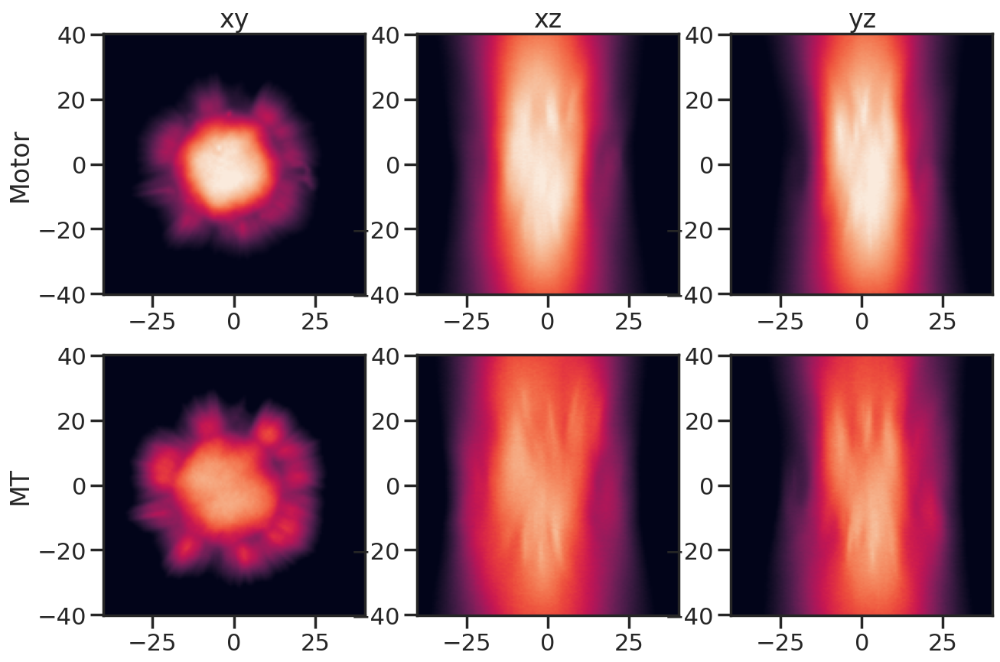

In [214]:
###### image dimentions listed in voxel size in "show info" part of fiji
umperpxXY = 296.14/512
umperpxZ = 60/120

xcent = 993
ycent = 630
zcent = int(161//2)

numum = 161*umperpxZ
zl = int(zcent - numum/(2*umperpxZ))
zh = int(zcent + numum/(2*umperpxZ))
xl = int(xcent - numum/(2*umperpxXY))
xh = int(xcent + numum/(2*umperpxXY))
yl = int(ycent - numum/(2*umperpxXY))
yh = int(ycent + numum/(2*umperpxXY))

extent=(-numum/2, numum/2, -numum/2, numum/2)
        
fig, ax=plt.subplots(2, 3, figsize=(15,10))
ax[0,0].imshow(rawIms_mot[zcent, yl:yh, xl:xh], extent = extent, vmin=10000,  vmax=50000)
ax[0,1].imshow(rawIms_mot[zl:zh, ycent, xl:xh], extent=extent, vmin=10000,  vmax=50000)
ax[0,2].imshow(rawIms_mot[zl:zh, yl:yh, xcent], extent=extent, vmin=10000,  vmax=50000)

ax[1,0].imshow(rawIms_mt[zcent, yl:yh, xl:xh], extent = extent, vmin=5000,  vmax=25000)
ax[1,1].imshow(rawIms_mt[zl:zh, ycent, xl:xh], extent=extent, vmin=5000,  vmax=25000)
ax[1,2].imshow(rawIms_mt[zl:zh, yl:yh, xcent], extent=extent, vmin=5000,  vmax=25000)

ax[0,0].set_title('xy')
ax[0,1].set_title('xz')
ax[0,2].set_title('yz')

ax[0,0].set_ylabel('Motor')
ax[1,0].set_ylabel('MT')

In [232]:
deconvIms.shape

(120, 512, 512)

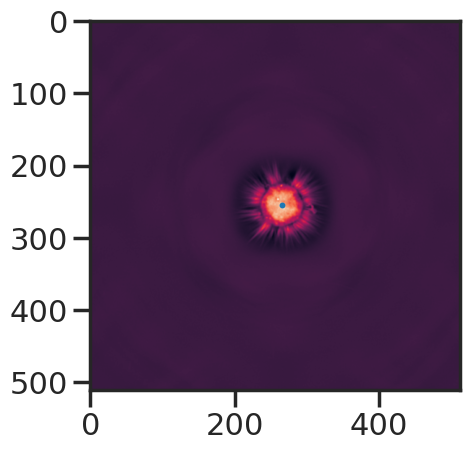

In [228]:
plt.imshow(deconvIms[60])
plt.scatter(265, 255, s=5)

Text(0, 0.5, 'Motor')

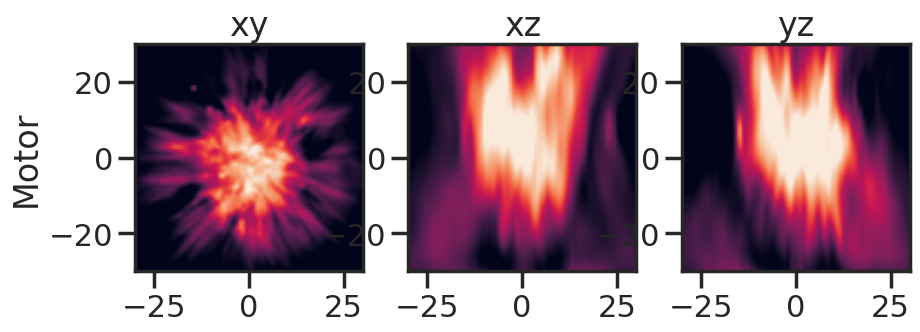

In [233]:
###### image dimentions listed in voxel size in "show info" part of fiji
umperpxXY = 296.14/512
umperpxZ = 60/120

xcent = 265
ycent = 255
zcent = int(161//2)

numum = 120*umperpxZ
zl = int(zcent - numum/(2*umperpxZ))
zh = int(zcent + numum/(2*umperpxZ))
xl = int(xcent - numum/(2*umperpxXY))
xh = int(xcent + numum/(2*umperpxXY))
yl = int(ycent - numum/(2*umperpxXY))
yh = int(ycent + numum/(2*umperpxXY))

extent=(-numum/2, numum/2, -numum/2, numum/2)
        
fig, ax=plt.subplots(1, 3, figsize=(10,5))
ax[0].imshow(deconvIms[zcent, yl:yh, xl:xh], extent = extent, vmin=10000,  vmax=100000)
ax[1].imshow(deconvIms[zl:zh, ycent, xl:xh], extent=extent, vmin=10000,  vmax=100000)
ax[2].imshow(deconvIms[zl:zh, yl:yh, xcent], extent=extent, vmin=10000,  vmax=100000)

ax[0].set_title('xy')
ax[1].set_title('xz')
ax[2].set_title('yz')

ax[0].set_ylabel('Motor')

In [242]:
deconvIms.shape

(120, 512, 512)

In [244]:
motStack.shape

(120, 512, 512)

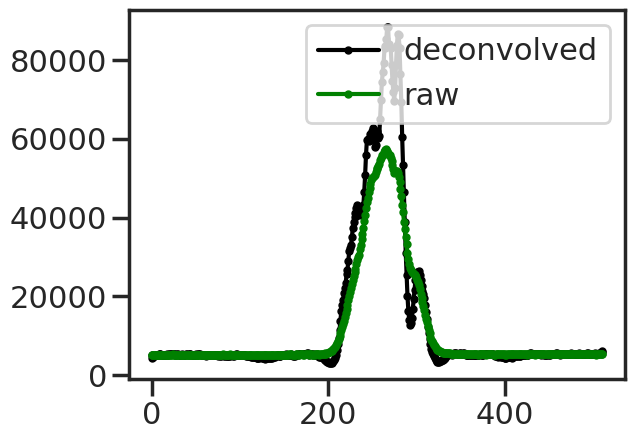

In [247]:
plt.plot(deconvIms[zcent, (yl+yh)//2, :], 'ko-', label='deconvolved', ms=5)
plt.plot(motStack[zcent, (yl+yh)//2, :], 'go-', label='raw', ms=5)
plt.legend()

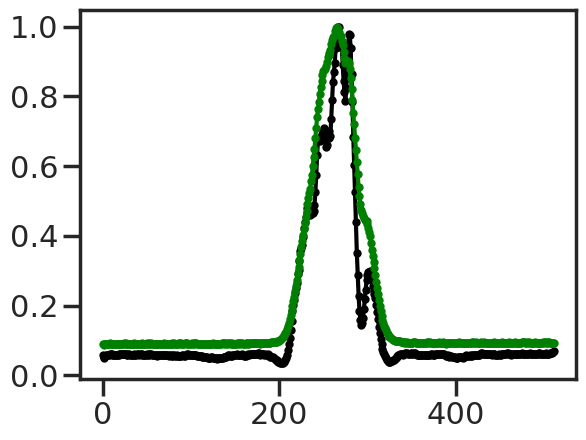

In [246]:
plt.plot(deconvIms[zcent, (yl+yh)//2, :]/max(deconvIms[zcent, (yl+yh)//2, :]), 'ko-', label='deconvolved', ms=5)
plt.plot(motStack[zcent, (yl+yh)//2, :]/max(motStack[zcent, (yl+yh)//2, :]), 'go-', label='raw', ms=5)

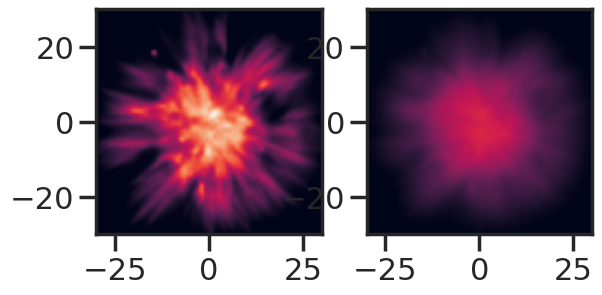

In [328]:
umperpxXY = 296.14/512
umperpxZ = 60/120

xcent = 265
ycent = 255
zcent = int(161//2)

numum = 120*umperpxZ
zl = int(zcent - numum/(2*umperpxZ))
zh = int(zcent + numum/(2*umperpxZ))
xl = int(xcent - numum/(2*umperpxXY))
xh = int(xcent + numum/(2*umperpxXY))
yl = int(ycent - numum/(2*umperpxXY))
yh = int(ycent + numum/(2*umperpxXY))

extent=(-numum/2, numum/2, -numum/2, numum/2)
        
fig, ax = plt.subplots(1,2)
ax[0].imshow(deconvIms[zcent, yl:yh, xl:xh], extent = extent, vmin=10000,  vmax=100000)
ax[1].imshow(motStack[zcent, yl:yh, xl:xh], extent = extent, vmin=10000,  vmax=100000)

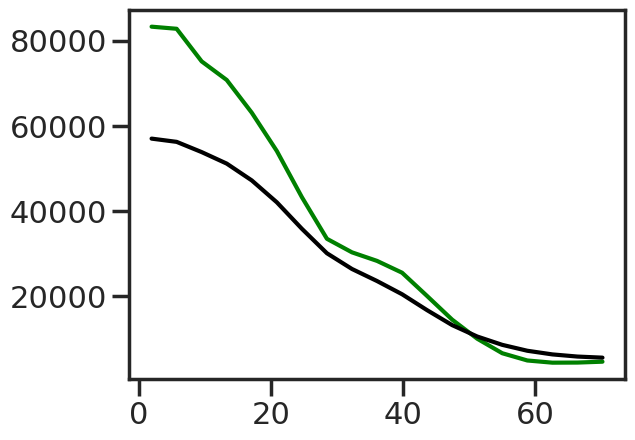

In [262]:
#radially average

plt.plot(*polarAverage(deconvIms[zcent, yl:yh, xl:xh]), color='green')
plt.plot(*polarAverage(motStack[zcent, yl:yh, xl:xh]), color='k')


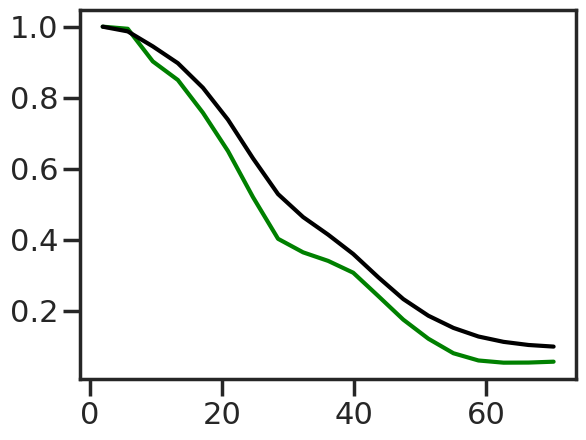

In [261]:
#radially average
rDec, rAvgDecs=polarAverage(deconvIms[zcent, yl:yh, xl:xh])
plt.plot(rDec, rAvgDecs/rAvgDecs.max(), color='green')
rRaw, rAvgRaws=polarAverage(motStack[zcent, yl:yh, xl:xh])
plt.plot(rRaw, rAvgRaws/rAvgRaws.max(), color='k')


In [263]:
zcent

80

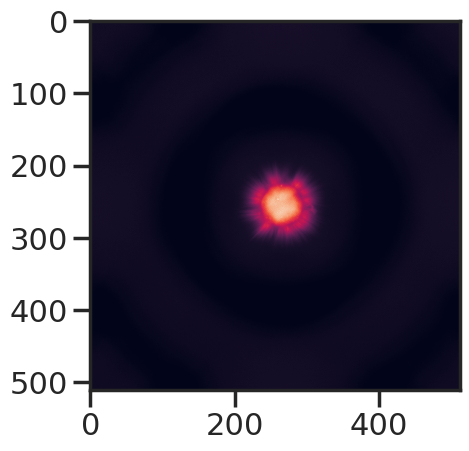

In [324]:
plt.imshow(twoDRL)

In [325]:
twoDRL.shape

(512, 512)

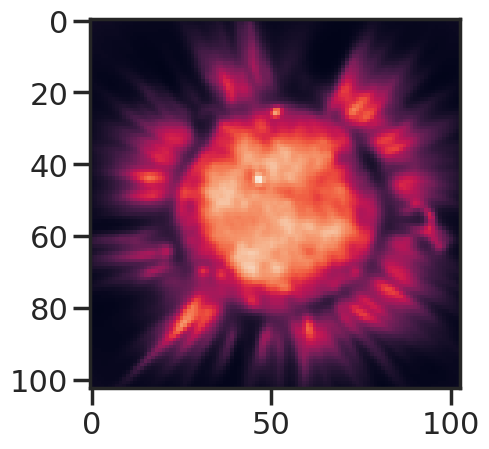

In [329]:
plt.imshow(deconvIms[60, yl:yh, xl:xh])

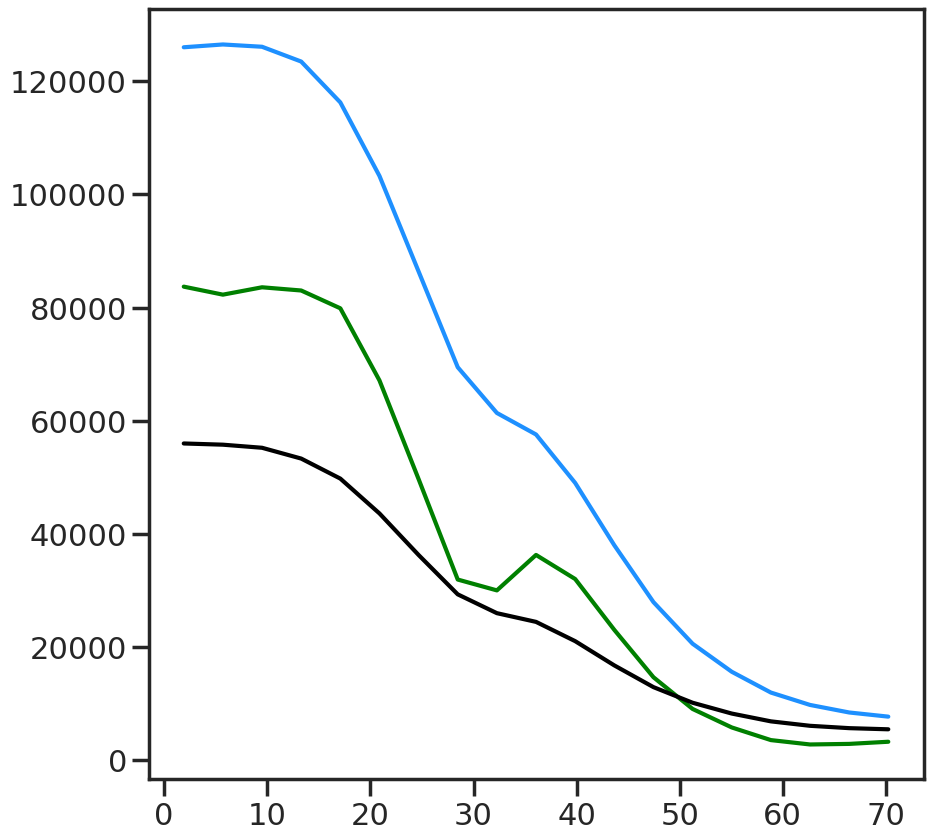

In [338]:
### what happens when we deconvolve just in lateral direction?



fig, ax = plt.subplots(figsize=(10,10))
#radially average
rDec, rAvgDecs=polarAverage(deconvIms[60, yl:yh, xl:xh])
plt.plot(rDec, rAvgDecs, color='green')
#plt.plot(rDec, rAvgDecs/rAvgDecs.max(), color='green', label='3d-deconvolved')
rRaw, rAvgRaws=polarAverage(motStack[60, yl:yh, xl:xh])
plt.plot(rRaw, rAvgRaws, color='k')
#plt.plot(rRaw, rAvgRaws/rAvgRaws.max(), color='k', label='raw')

rDec2D, rAvgDecs2D=polarAverage(twoDRL[yl:yh, xl:xh])
plt.plot(rDec2D, rAvgDecs2D, color='dodgerblue')
#plt.plot(rDec2D, rAvgDecs2D/rAvgDecs2D.max(), color='dodgerblue', label='2d-deconvolved')
#plt.legend()

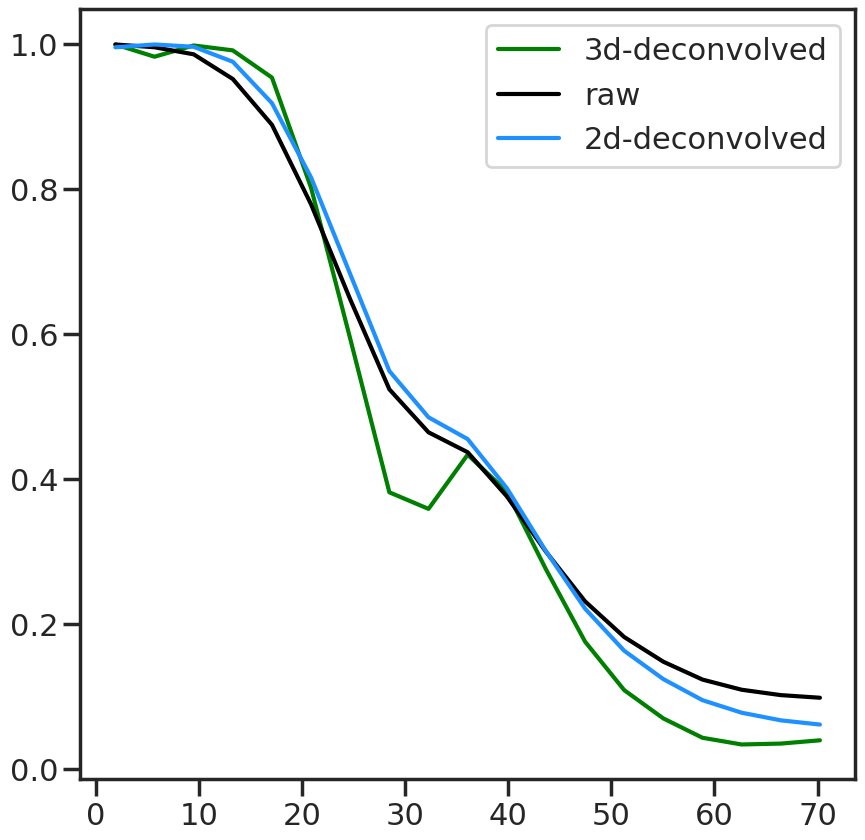

In [334]:
### what happens when we deconvolve just in lateral direction?



fig, ax = plt.subplots(figsize=(10,10))
#radially average
rDec, rAvgDecs=polarAverage(deconvIms[60, yl:yh, xl:xh])
#plt.plot(rDec, rAvgDecs, color='green')
plt.plot(rDec, rAvgDecs/rAvgDecs.max(), color='green', label='3d-deconvolved')
rRaw, rAvgRaws=polarAverage(motStack[60, yl:yh, xl:xh])
#plt.plot(rRaw, rAvgRaws, color='k')
plt.plot(rRaw, rAvgRaws/rAvgRaws.max(), color='k', label='raw')

rDec2D, rAvgDecs2D=polarAverage(twoDRL[yl:yh, xl:xh])
#plt.plot(rDec2D, rAvgDecs2D, color='dodgerblue')
plt.plot(rDec2D, rAvgDecs2D/rAvgDecs2D.max(), color='dodgerblue', label='2d-deconvolved')
plt.legend()

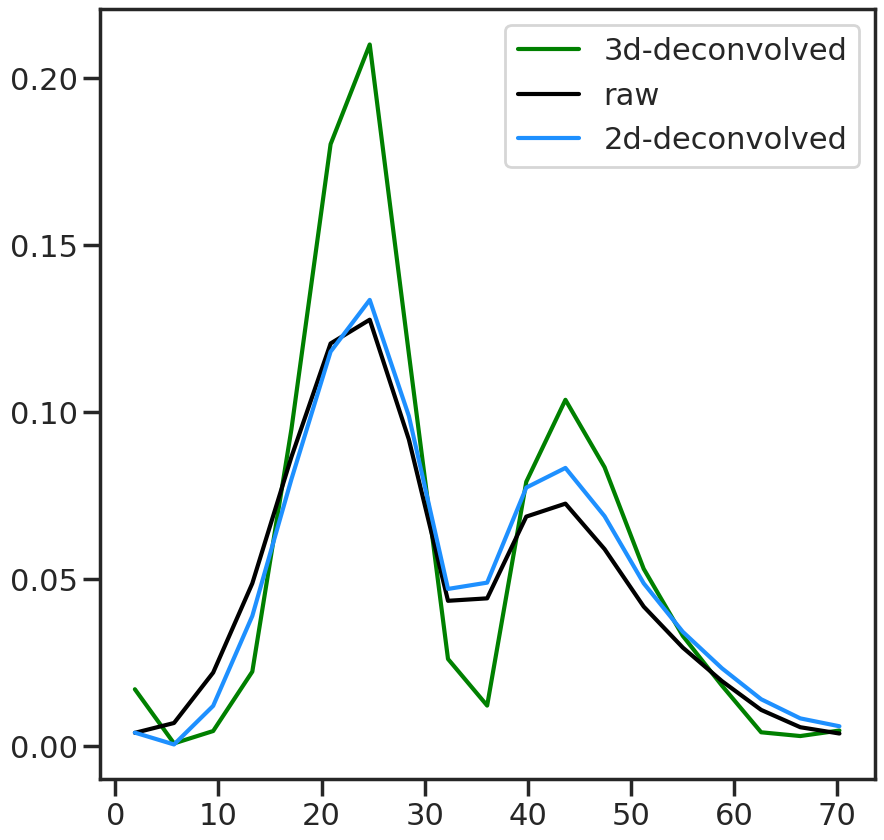

In [336]:
### plot the local spatial derivatives [what happens when we deconvolve just in lateral direction?]



fig, ax = plt.subplots(figsize=(10,10))
#radially average
rDec, rAvgDecs=polarAverage(deconvIms[60, yl:yh, xl:xh])
#plt.plot(rDec, rAvgDecs, color='green')
plt.plot(rDec, np.abs(np.gradient(rAvgDecs/rAvgDecs.max())), color='green', label='3d-deconvolved')
rRaw, rAvgRaws=polarAverage(motStack[60, yl:yh, xl:xh])
#plt.plot(rRaw, rAvgRaws, color='k')
plt.plot(rRaw, np.abs(np.gradient(rAvgRaws/rAvgRaws.max())), color='k', label='raw')

rDec2D, rAvgDecs2D=polarAverage(twoDRL[yl:yh, xl:xh])
#plt.plot(rDec2D, rAvgDecs2D, color='dodgerblue')
plt.plot(rDec2D, np.abs(np.gradient(rAvgDecs2D/rAvgDecs2D.max())), color='dodgerblue', label='2d-deconvolved')
plt.legend()

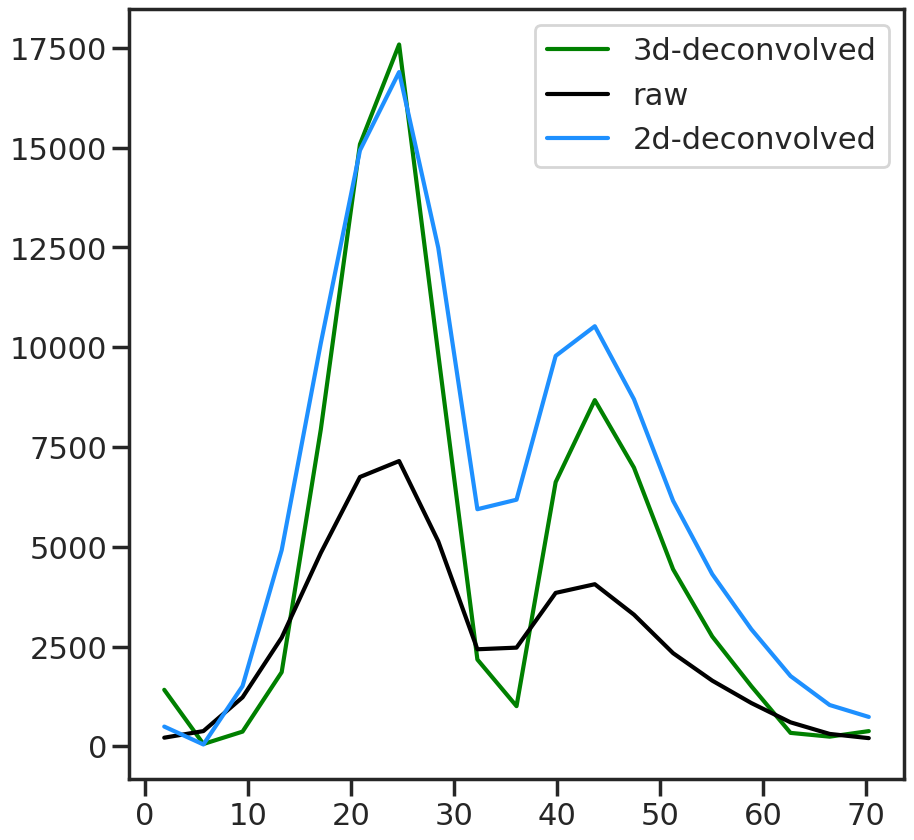

In [337]:
### plot the local spatial derivatives [what happens when we deconvolve just in lateral direction?]

fig, ax = plt.subplots(figsize=(10,10))
#radially average
rDec, rAvgDecs=polarAverage(deconvIms[60, yl:yh, xl:xh])
#plt.plot(rDec, rAvgDecs, color='green')
plt.plot(rDec, np.abs(np.gradient(rAvgDecs)), color='green', label='3d-deconvolved')
rRaw, rAvgRaws=polarAverage(motStack[60, yl:yh, xl:xh])
#plt.plot(rRaw, rAvgRaws, color='k')
plt.plot(rRaw, np.abs(np.gradient(rAvgRaws)), color='k', label='raw')

rDec2D, rAvgDecs2D=polarAverage(twoDRL[yl:yh, xl:xh])
#plt.plot(rDec2D, rAvgDecs2D, color='dodgerblue')
plt.plot(rDec2D, np.abs(np.gradient(rAvgDecs2D)), color='dodgerblue', label='2d-deconvolved')
plt.legend()

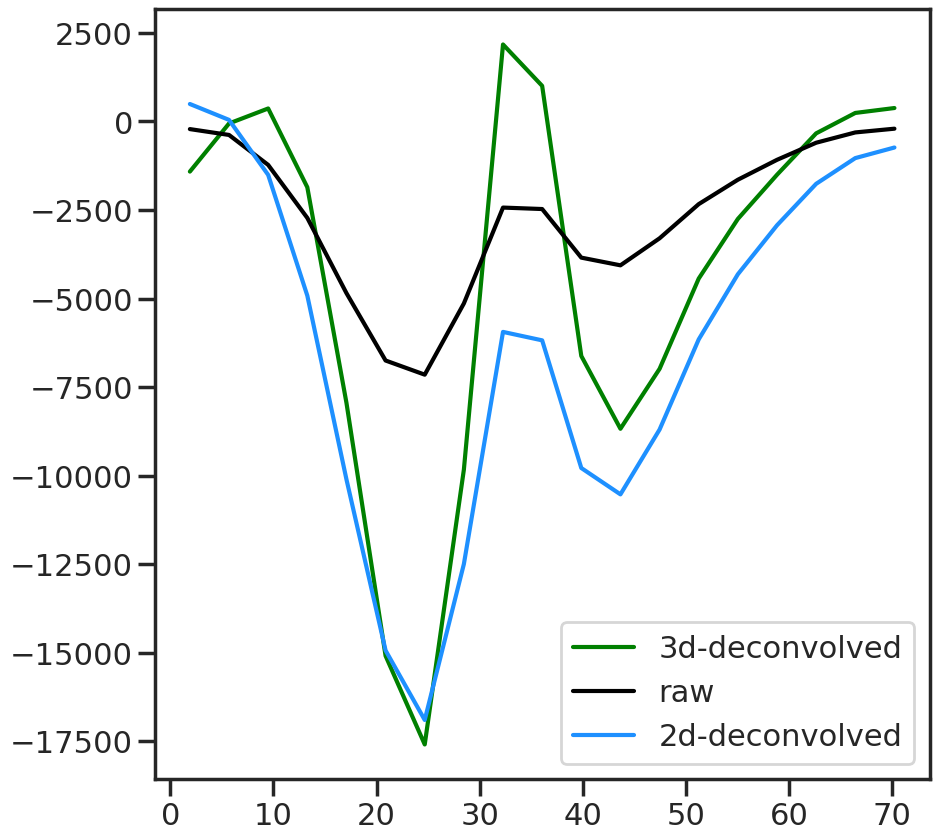

In [339]:
### NO abs
### plot the local spatial derivatives [what happens when we deconvolve just in lateral direction?]

fig, ax = plt.subplots(figsize=(10,10))
#radially average
rDec, rAvgDecs=polarAverage(deconvIms[60, yl:yh, xl:xh])
#plt.plot(rDec, rAvgDecs, color='green')
plt.plot(rDec, np.gradient(rAvgDecs), color='green', label='3d-deconvolved')
rRaw, rAvgRaws=polarAverage(motStack[60, yl:yh, xl:xh])
#plt.plot(rRaw, rAvgRaws, color='k')
plt.plot(rRaw, np.gradient(rAvgRaws), color='k', label='raw')

rDec2D, rAvgDecs2D=polarAverage(twoDRL[yl:yh, xl:xh])
#plt.plot(rDec2D, rAvgDecs2D, color='dodgerblue')
plt.plot(rDec2D, np.gradient(rAvgDecs2D), color='dodgerblue', label='2d-deconvolved')
plt.legend()

/tmp/ipykernel_1780770/4226055686.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(10,10))


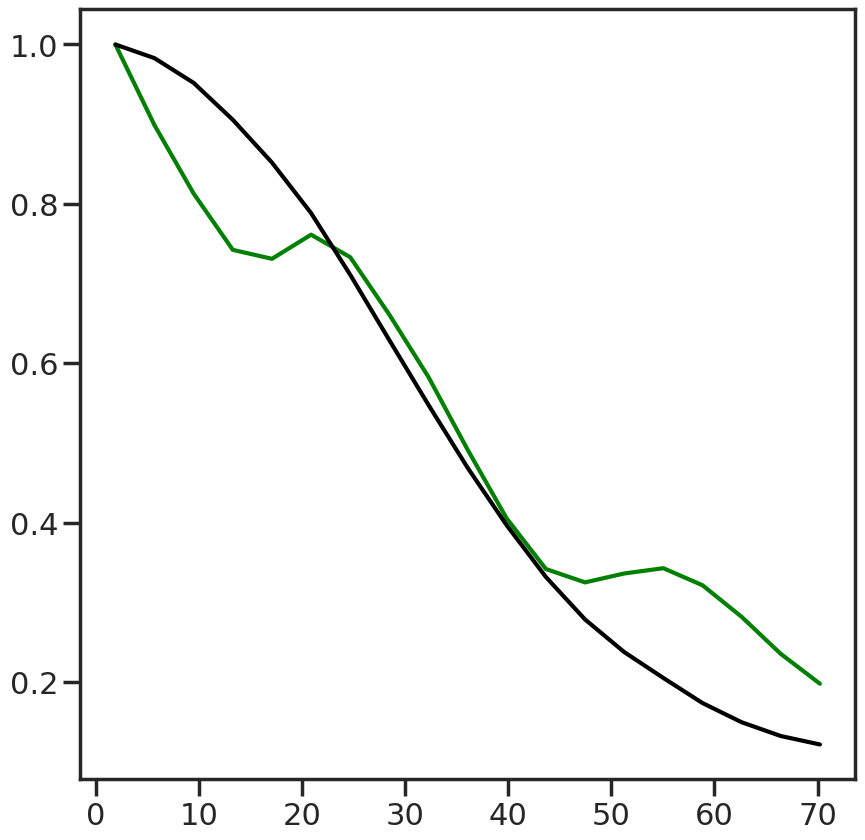

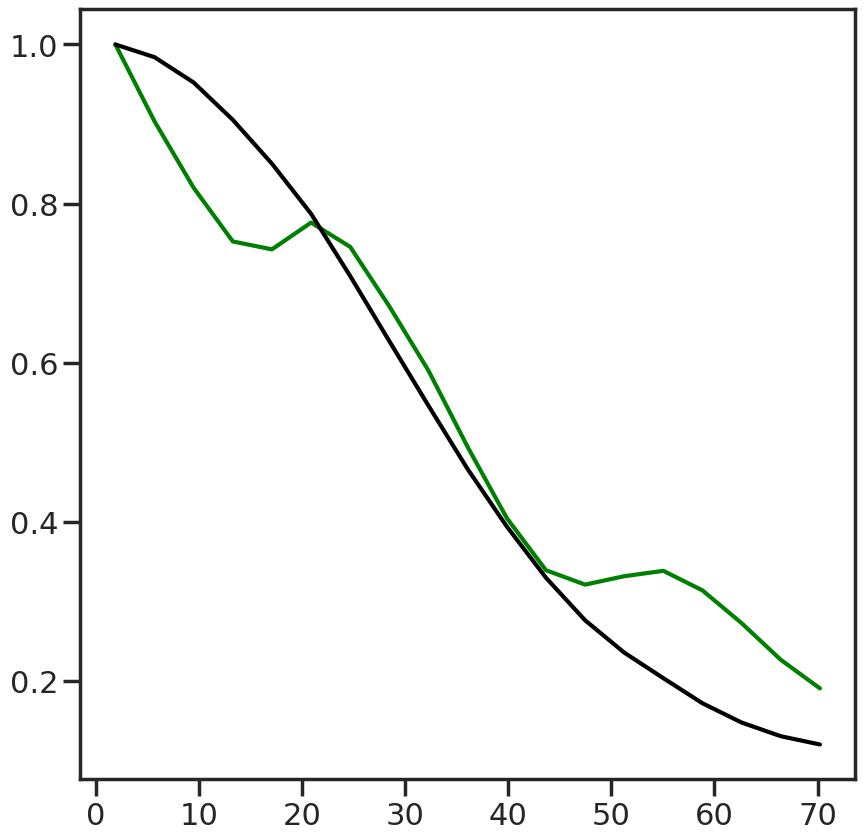

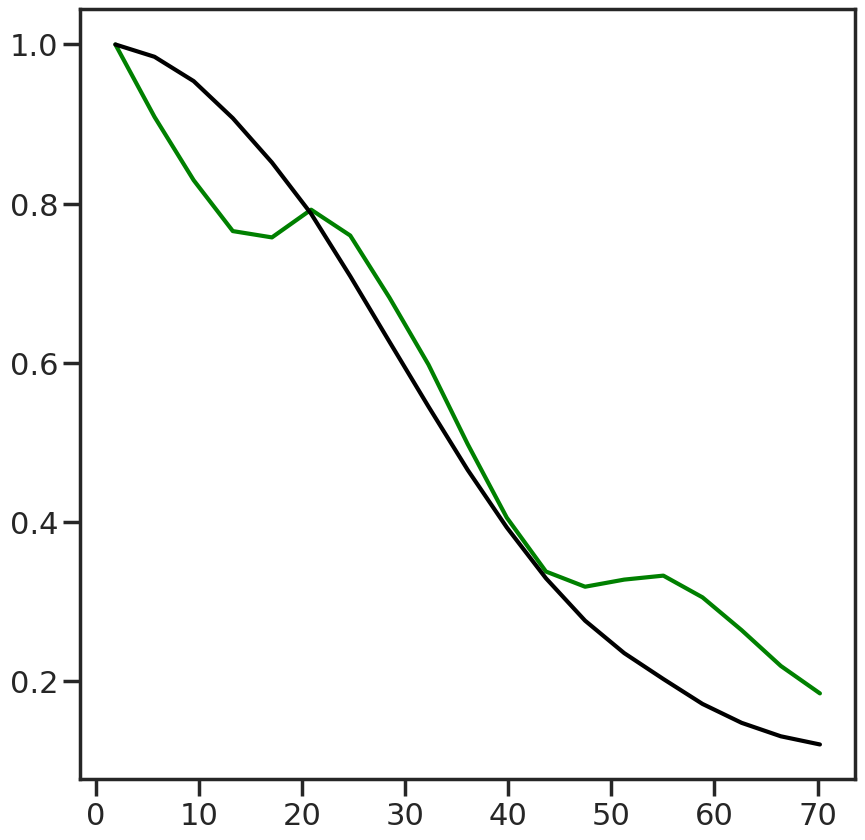

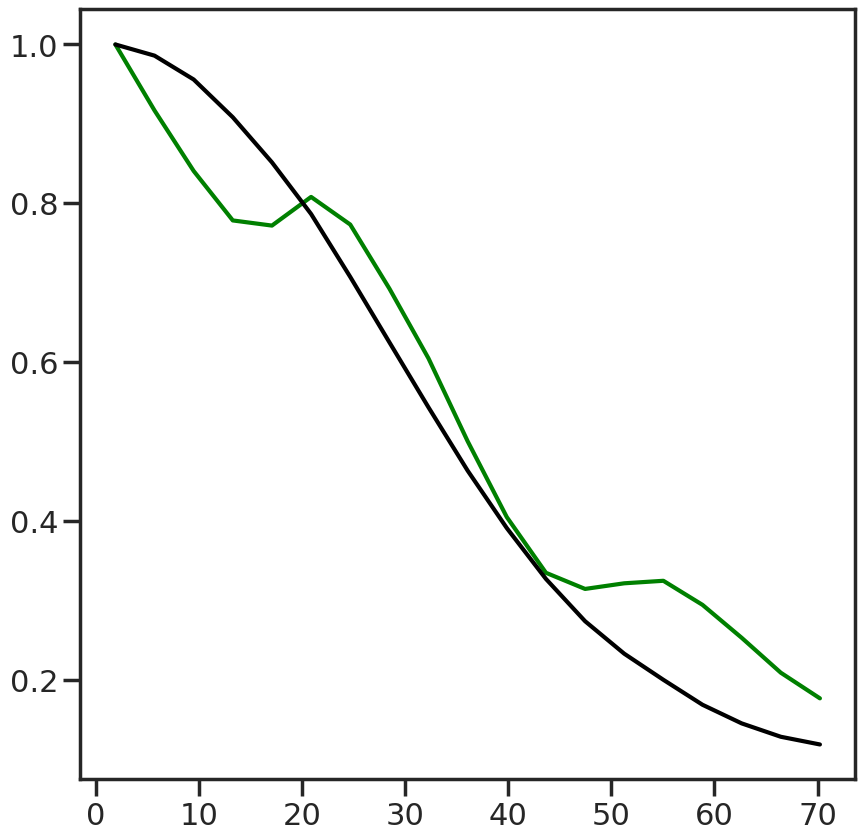

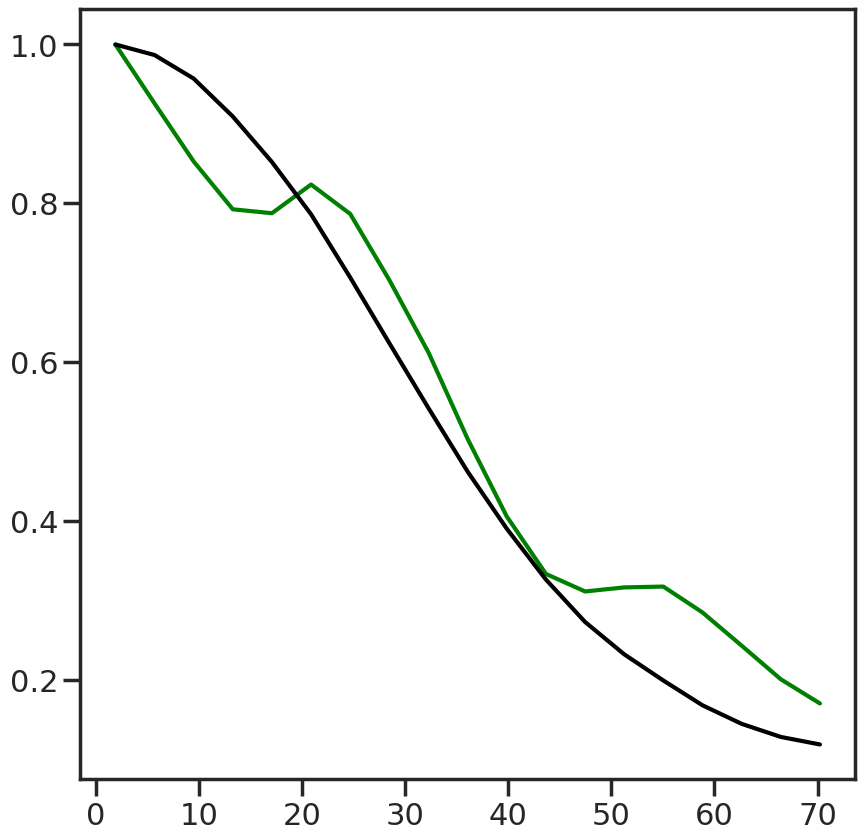

...

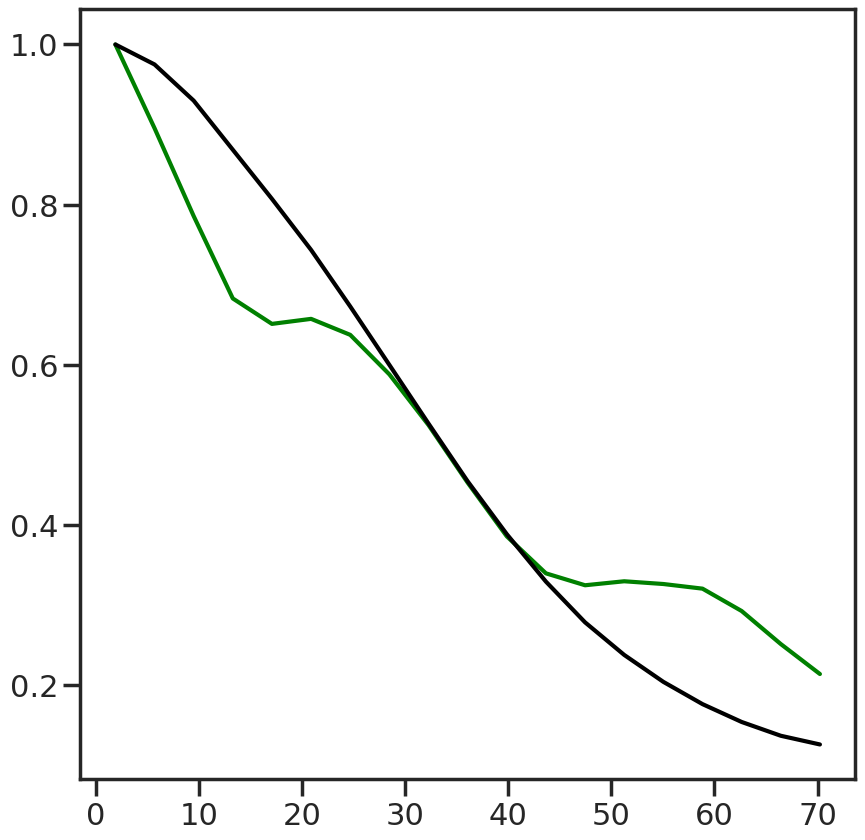

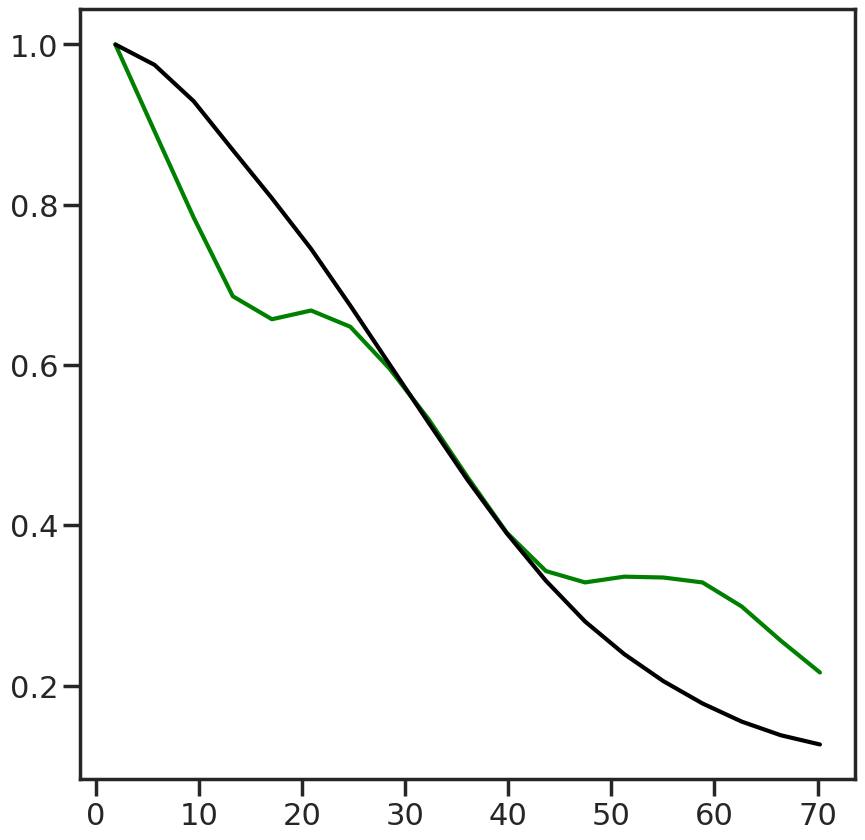

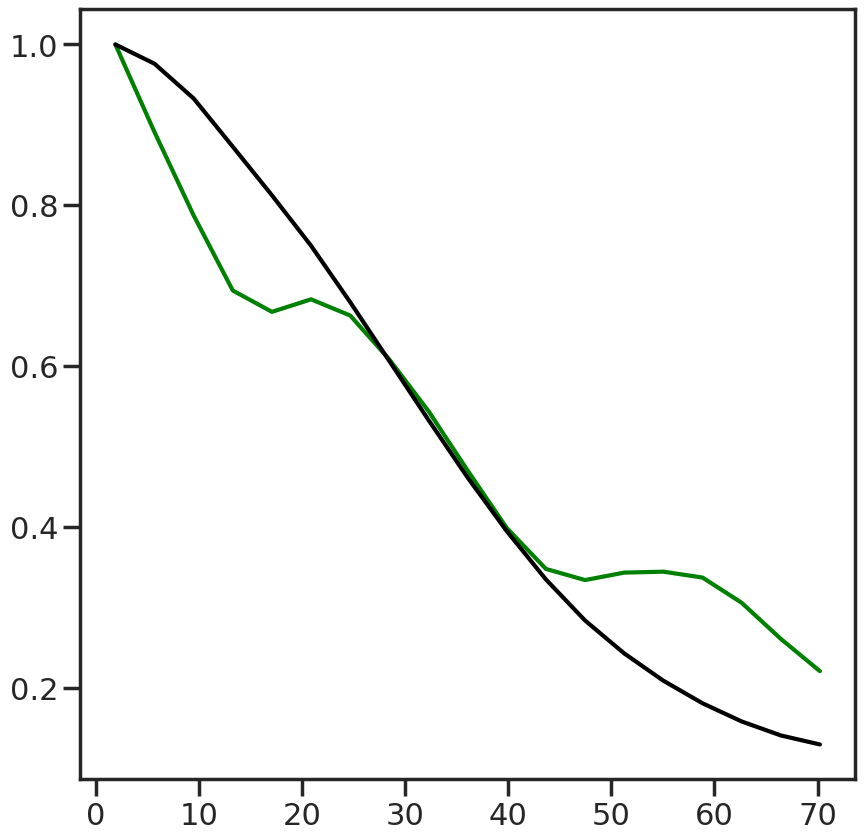

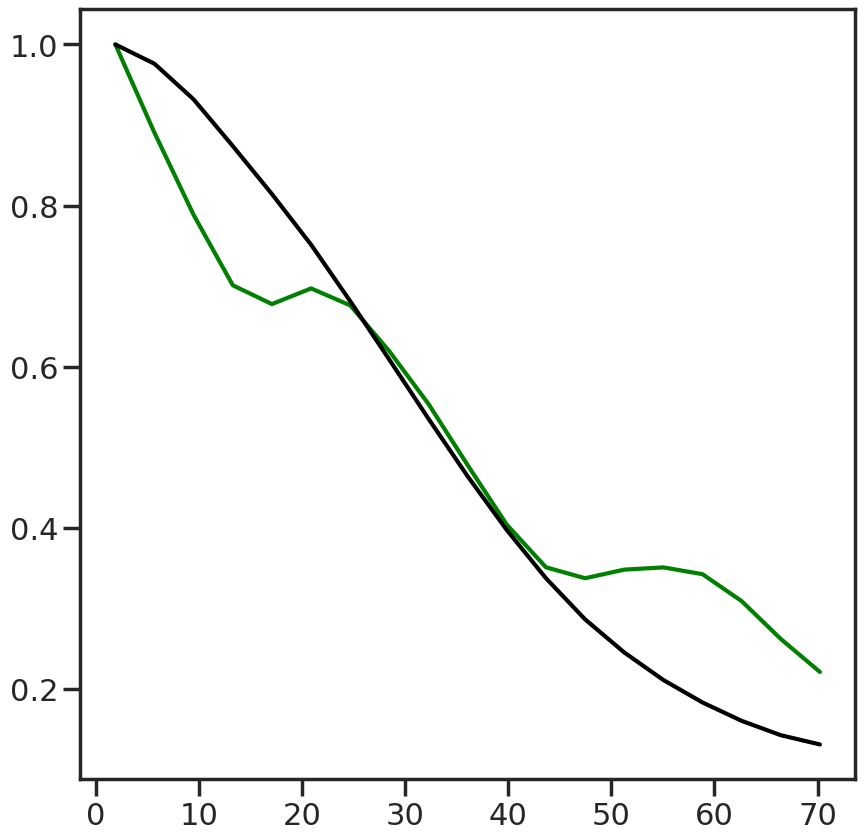

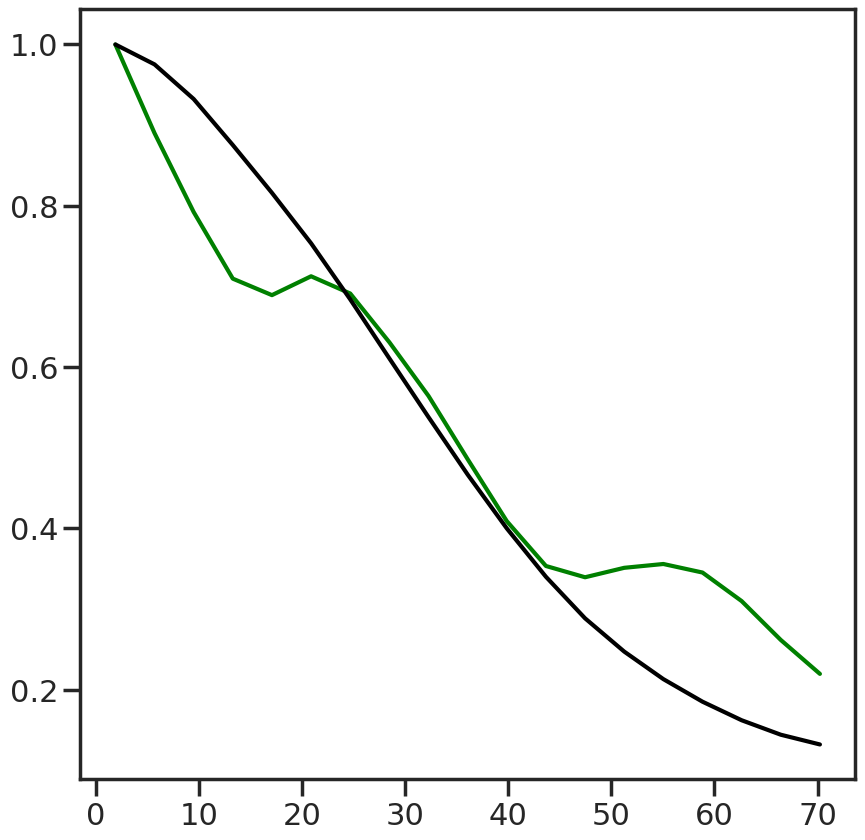

In [268]:
for z in range(120):#[10, 20, 30, 40, 50, 60, 70, 80, 90, 100]:
    fig, ax = plt.subplots(figsize=(10,10))
    zcent=z
    #radially average
    rDec, rAvgDecs=polarAverage(deconvIms[zcent, yl:yh, xl:xh])
    plt.plot(rDec, rAvgDecs/rAvgDecs.max(), color='green')
    #plt.plot(rDec, rAvgDecs, color='green')
    rRaw, rAvgRaws=polarAverage(motStack[zcent, yl:yh, xl:xh])
    plt.plot(rRaw, rAvgRaws/rAvgRaws.max(), color='k')

    #plt.plot(rRaw, rAvgRaws, color='k')


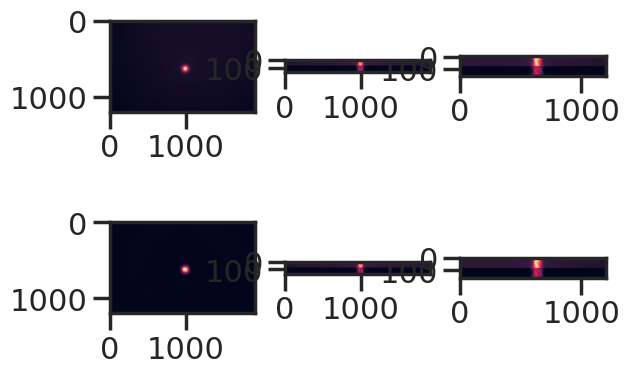

In [129]:
fig, ax=plt.subplots(2, 3)
ax[0,0].imshow(rawIms[0][rawIms[0].shape[0]//2])
ax[0,1].imshow(rawIms[0][:, rawIms[0].shape[1]//2, :])
ax[0,2].imshow(rawIms[0][:, :, rawIms[0].shape[2]//2])

ax[1,0].imshow(rawIms[1][rawIms[0].shape[0]//2])
ax[1,1].imshow(rawIms[1][:, rawIms[0].shape[1]//2, :])
ax[1,2].imshow(rawIms[1][:, :, rawIms[0].shape[2]//2])

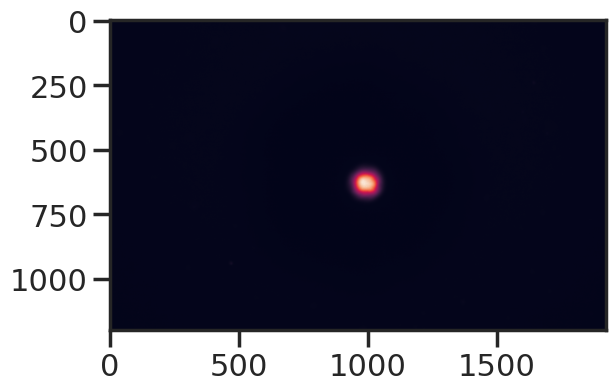

In [116]:
plt.imshow(rawIms[1][80])

In [6]:
# Subtract background
motStack_bs = motStack-1920

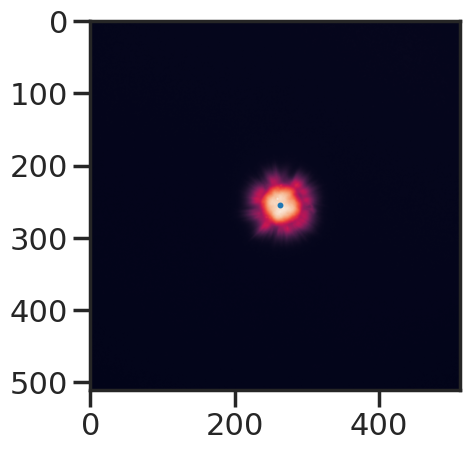

In [70]:
plt.imshow(motStack_bs[len(motStack)//2])
plt.scatter(263, 255, s=5)

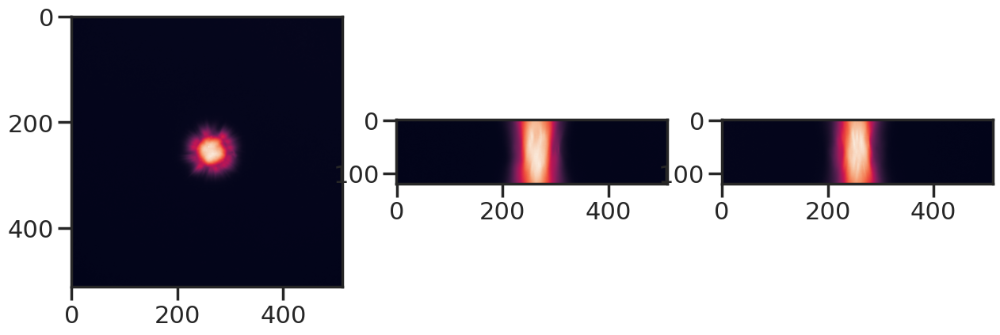

In [79]:
fig, ax = plt.subplots(1,3, figsize=(15, 5))
ax[0].imshow(motStack_bs[len(motStack)//2])
ax[1].imshow(motStack_bs[:, motStack.shape[1]//2,:])
ax[2].imshow(motStack_bs[:,:, motStack.shape[2]//2])


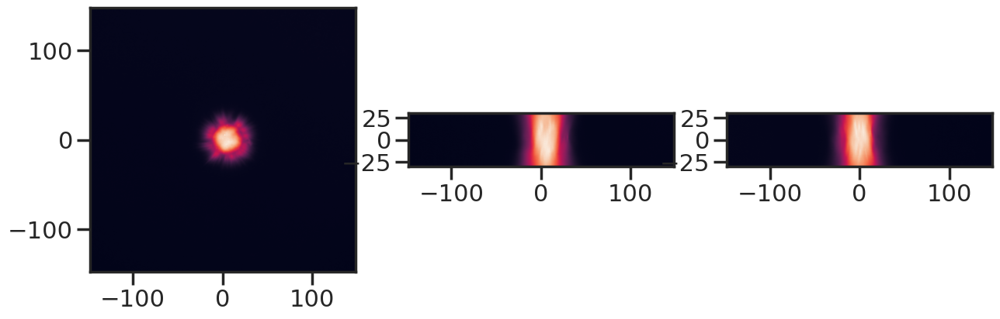

In [61]:
fig, ax = plt.subplots(1,3, figsize=(15, 5))
ax[0].imshow(motStack_bs[len(motStack)//2], extent=xyext)
ax[1].imshow(motStack_bs[:, motStack.shape[1]//2,:], extent=xzext)
ax[2].imshow(motStack_bs[:,:, motStack.shape[2]//2], extent=xzext)


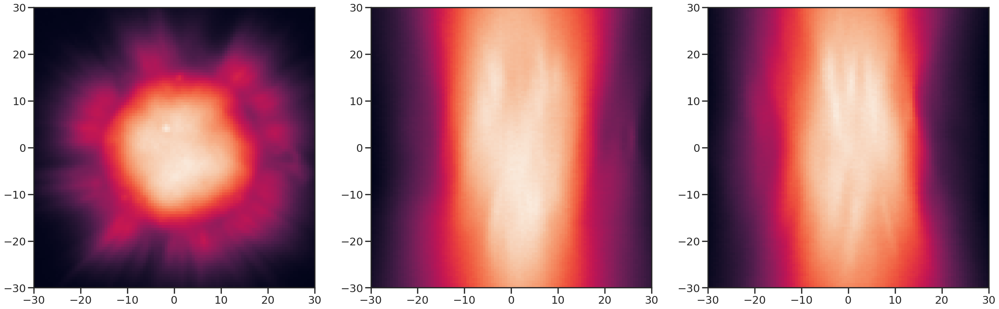

In [299]:
numum = 60
# zl = int(len(motStack)/2 - numum/(2*umperpxZ))
# zh = int(len(motStack)/2 + numum/(2*umperpxZ))
# xl = int(motStack.shape[1]/2 - numum/(2*umperpxXY))
# xh = int(motStack.shape[1]/2 + numum/(2*umperpxXY))
zl = int(len(motStack)/2 - numum/(2*umperpxZ))
zh = int(len(motStack)/2 + numum/(2*umperpxZ))
xl = int(263 - numum/(2*umperpxXY))
xh = int(263 + numum/(2*umperpxXY))
yl = int(255 - numum/(2*umperpxXY))
yh = int(255 + numum/(2*umperpxXY))

fig, ax = plt.subplots(1,3, figsize=(35, 35))
ax[0].imshow(motStack_bs[len(motStack)//2, yl:yh, xl:xh ], extent=(-numum/2, numum/2, -numum/2, numum/2))
ax[1].imshow(motStack_bs[zl:zh, motStack.shape[1]//2,xl:xh], extent=(-numum/2, numum/2, -numum/2, numum/2))
ax[2].imshow(motStack_bs[zl:zh,yl:yh, motStack.shape[2]//2], extent=(-numum/2, numum/2, -numum/2, numum/2))


# Gridlines based on minor ticks

plt.savefig('20250708_slice.pdf', bbox_inches='tight', transparent=True)

In [103]:
# fig, ax = plt.subplots(figsize=(10,10))
# ax.set_aspect('equal')
# ax.pcolormesh(motStack_bs[len(motStack)//2, yl:yh, xl:xh ], edgecolors='w', linewidth=0.01)
# ax.invert_yaxis()

In [50]:
(zh-zl)*umperpxZ, (xh-xl)*umperpxXY

(60.0, 59.5750390625)

In [17]:
deconv = restoration.richardson_lucy(motStack_bs, psfStack, num_iter=30)

# Nov 2

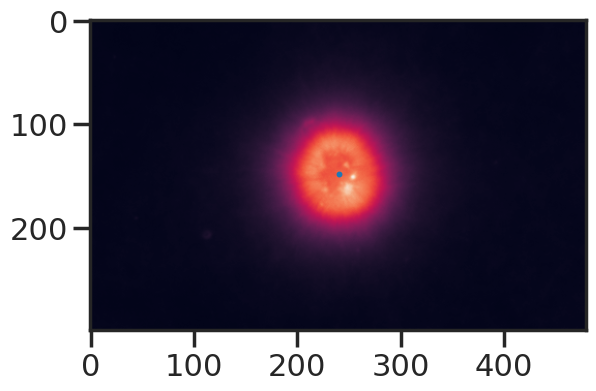

In [297]:
plt.imshow(motStacknov2[60])
plt.scatter(240, 148, s=5)


In [301]:
len(motStacknov2)/2

60.5

Text(0.5, 1.0, 'yz')

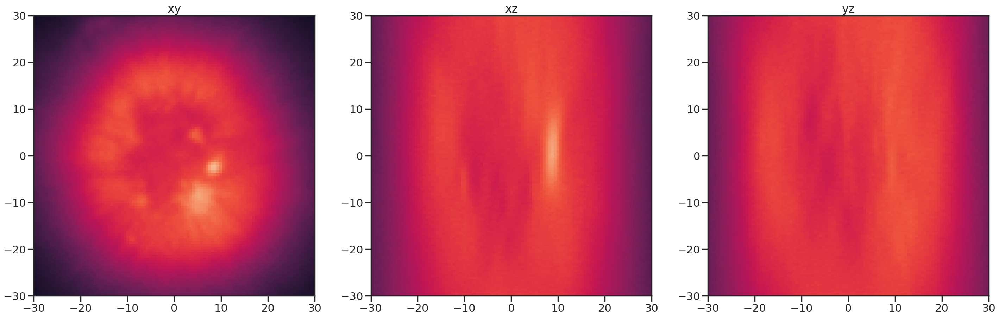

In [313]:
#not deconvolved
numum = 60
zl = int(len(motStacknov2)/2 - numum/(2*umperpxZ))
zh = int(len(motStacknov2)/2 + numum/(2*umperpxZ))
xl = int(240 - numum/(2*umperpxXY))
xh = int(240 + numum/(2*umperpxXY))
yl = int(148 - numum/(2*umperpxXY))
yh = int(148 + numum/(2*umperpxXY))

fig, ax = plt.subplots(1,3, figsize=(35, 35))
ax[0].imshow(motStacknov2[len(motStacknov2)//2, yl:yh, xl:xh ], extent=(-numum/2, numum/2, -numum/2, numum/2), vmin=5000, vmax=35000)
ax[1].imshow(motStacknov2[zl:zh, motStacknov2.shape[1]//2,xl:xh], extent=(-numum/2, numum/2, -numum/2, numum/2), vmin=5000, vmax=35000)
ax[2].imshow(motStacknov2[zl:zh,yl:yh, motStacknov2.shape[2]//2], extent=(-numum/2, numum/2, -numum/2, numum/2), vmin=5000, vmax=35000)

ax[0].set_title('xy')
ax[1].set_title('xz')
ax[2].set_title('yz')

# Gridlines based on minor ticks

#plt.savefig('20250708_slice.pdf', bbox_inches='tight', transparent=True)

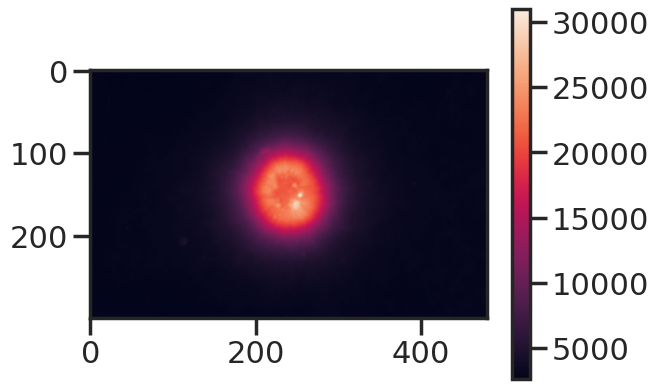

In [308]:
plt.imshow(motStacknov2[60])
plt.colorbar()

Text(0.5, 1.0, 'yz')

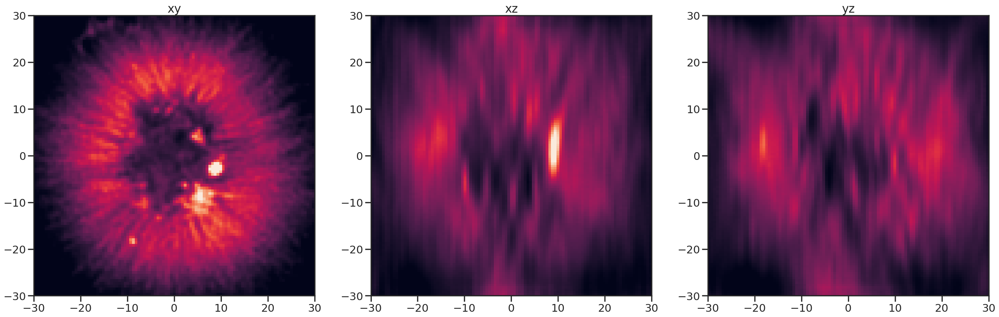

In [312]:
#not deconvolved
numum = 60
zl = int(len(deconvnov2)/2 - numum/(2*umperpxZ))
zh = int(len(deconvnov2)/2 + numum/(2*umperpxZ))
xl = int(240 - numum/(2*umperpxXY))
xh = int(240 + numum/(2*umperpxXY))
yl = int(148 - numum/(2*umperpxXY))
yh = int(148 + numum/(2*umperpxXY))

fig, ax = plt.subplots(1,3, figsize=(35, 35))
ax[0].imshow(deconvnov2[len(deconvnov2)//2, yl:yh, xl:xh ], extent=(-numum/2, numum/2, -numum/2, numum/2), vmin=10000, vmax=60000)
ax[1].imshow(deconvnov2[zl:zh, deconvnov2.shape[1]//2,xl:xh], extent=(-numum/2, numum/2, -numum/2, numum/2), vmin=10000, vmax=60000)
ax[2].imshow(deconvnov2[zl:zh,yl:yh, deconvnov2.shape[2]//2], extent=(-numum/2, numum/2, -numum/2, numum/2), vmin=10000, vmax=60000)

ax[0].set_title('xy')
ax[1].set_title('xz')
ax[2].set_title('yz')

/tmp/ipykernel_1780770/2402598719.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(10,10))


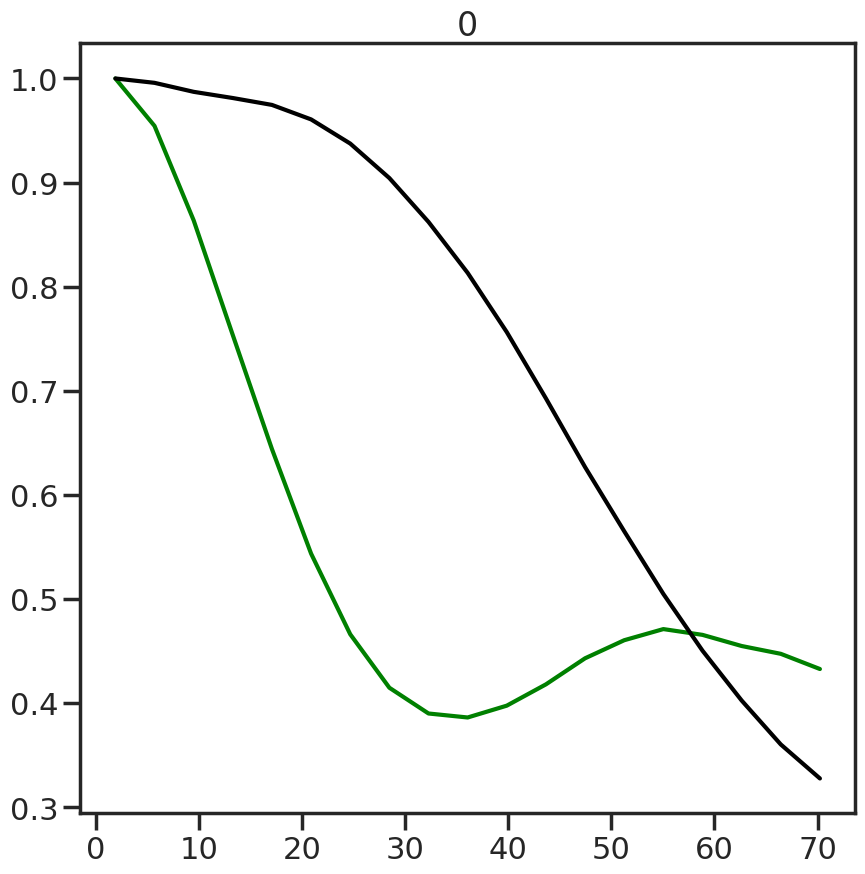

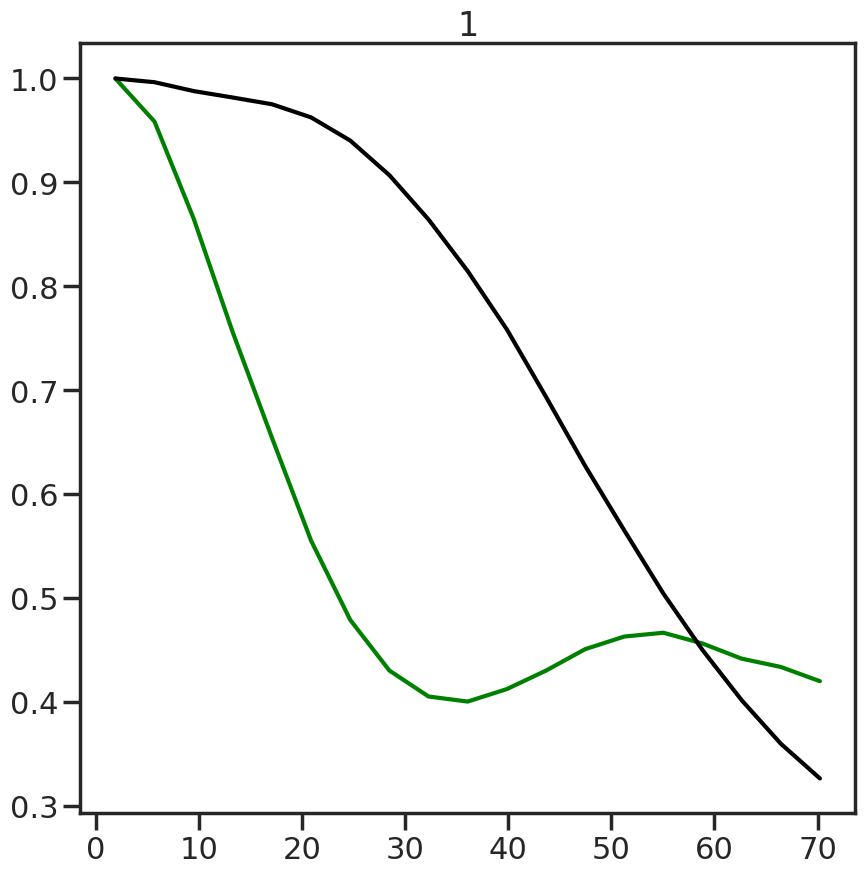

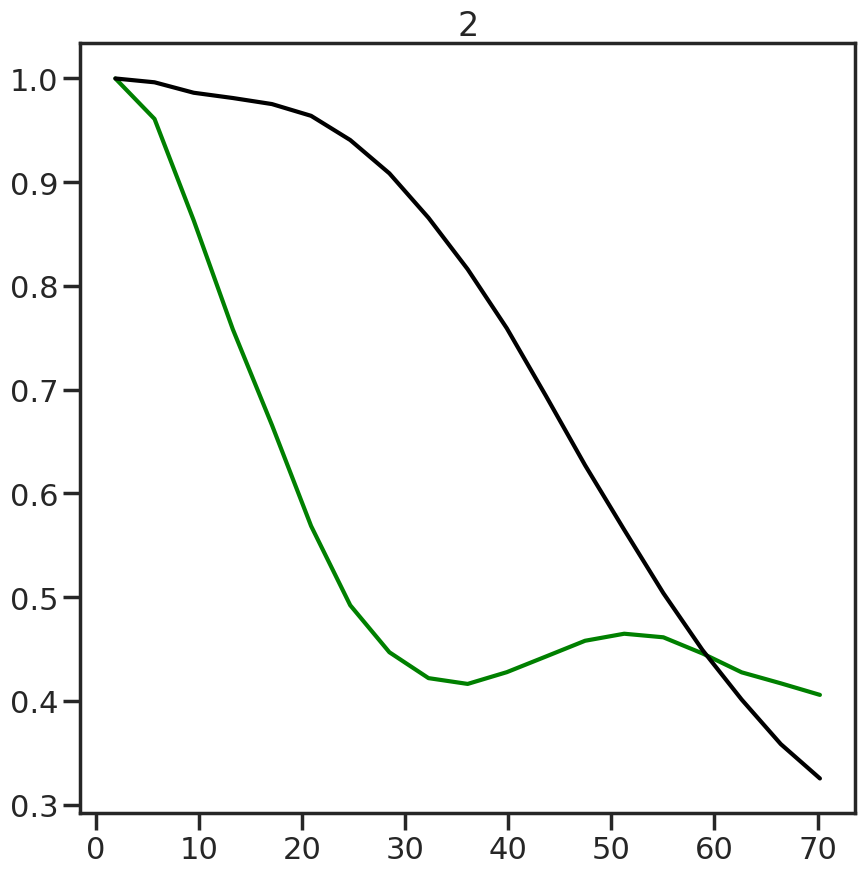

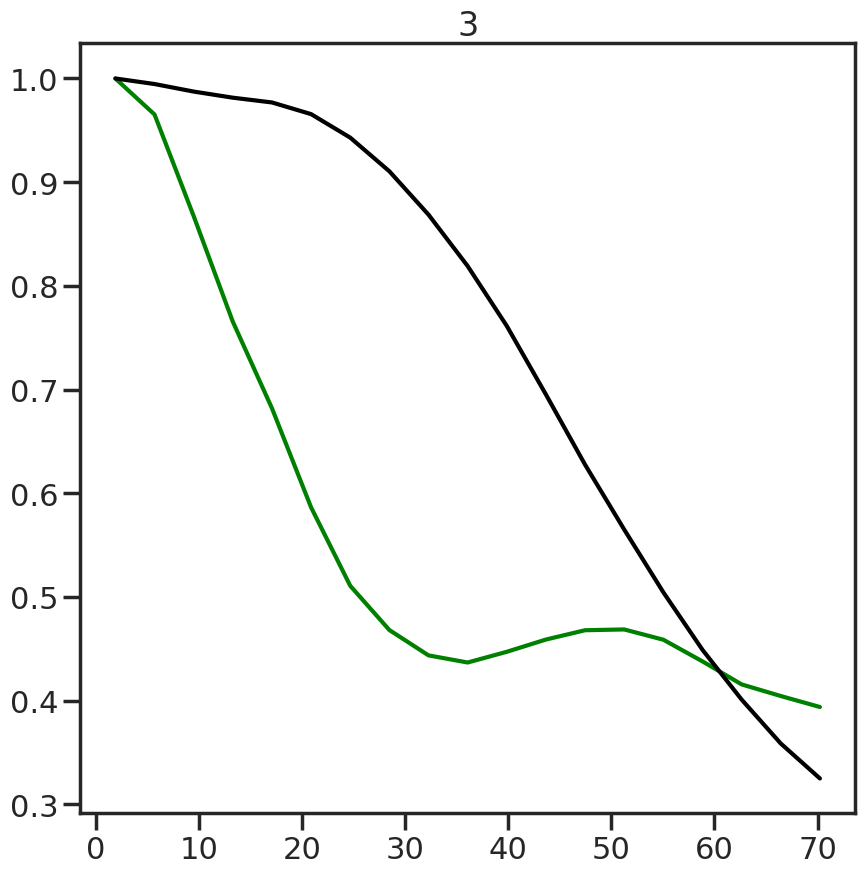

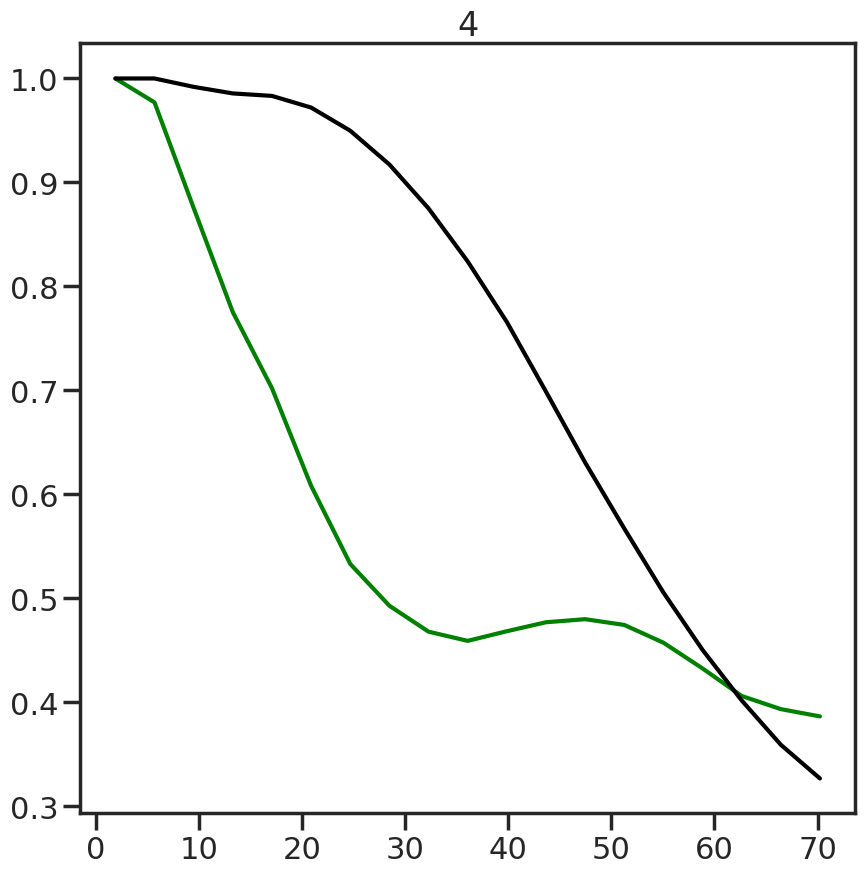

...

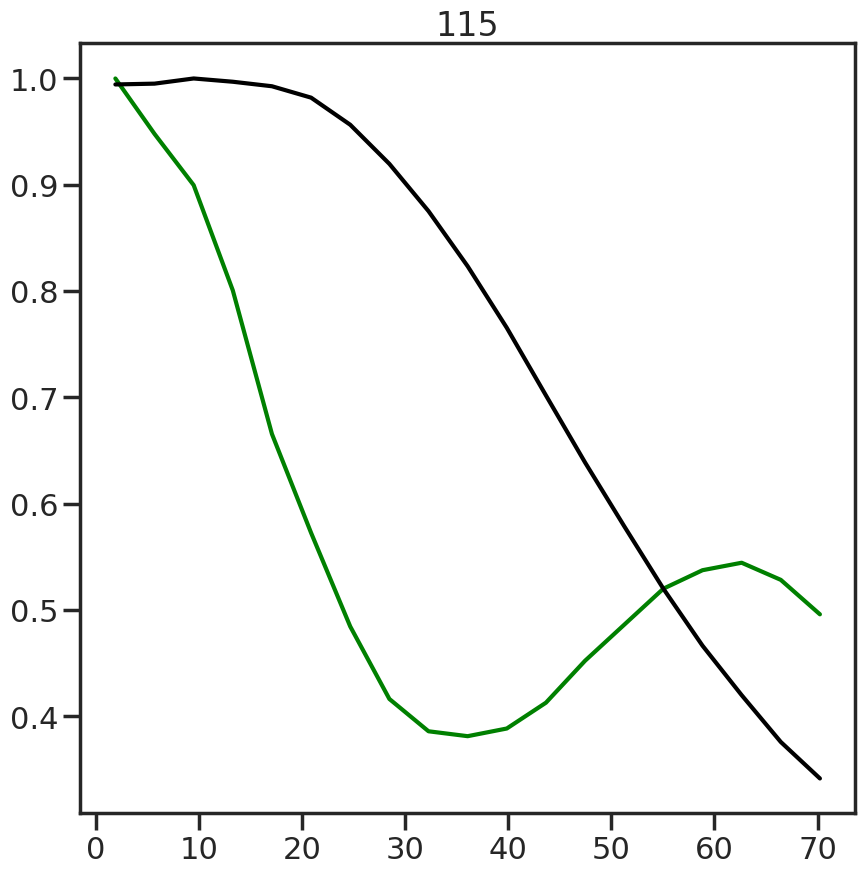

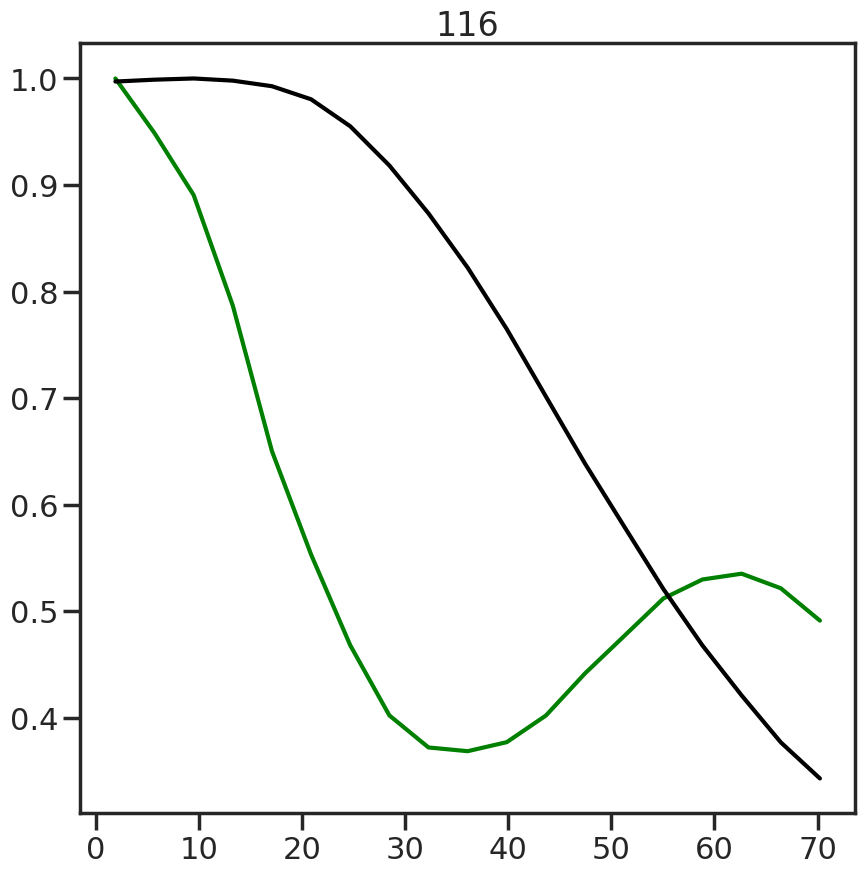

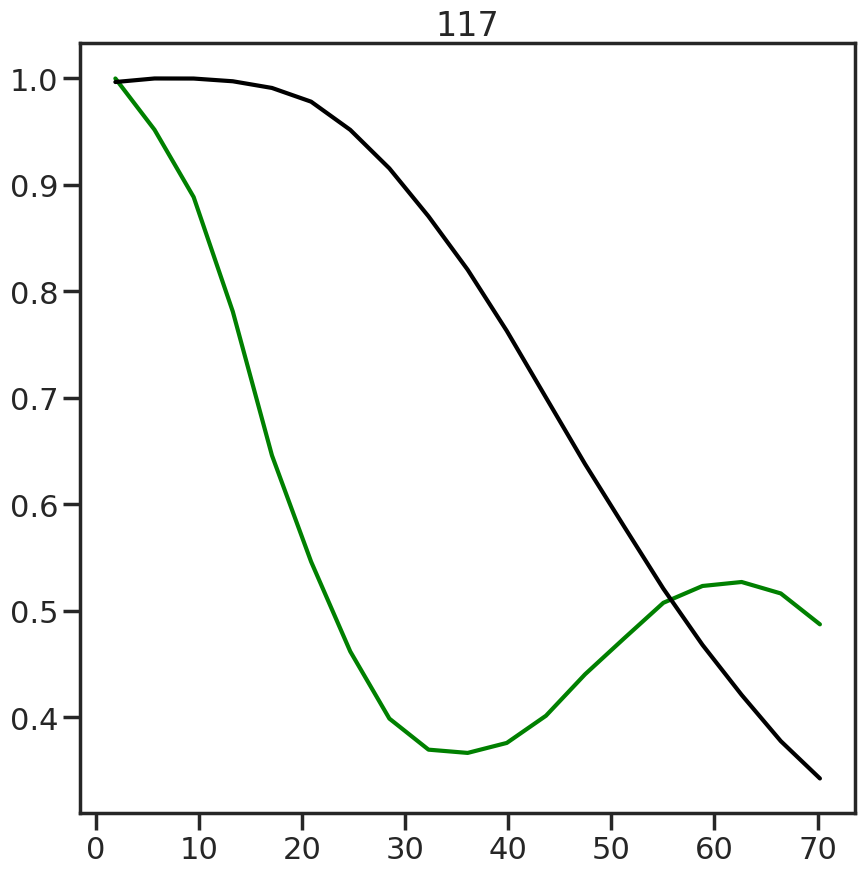

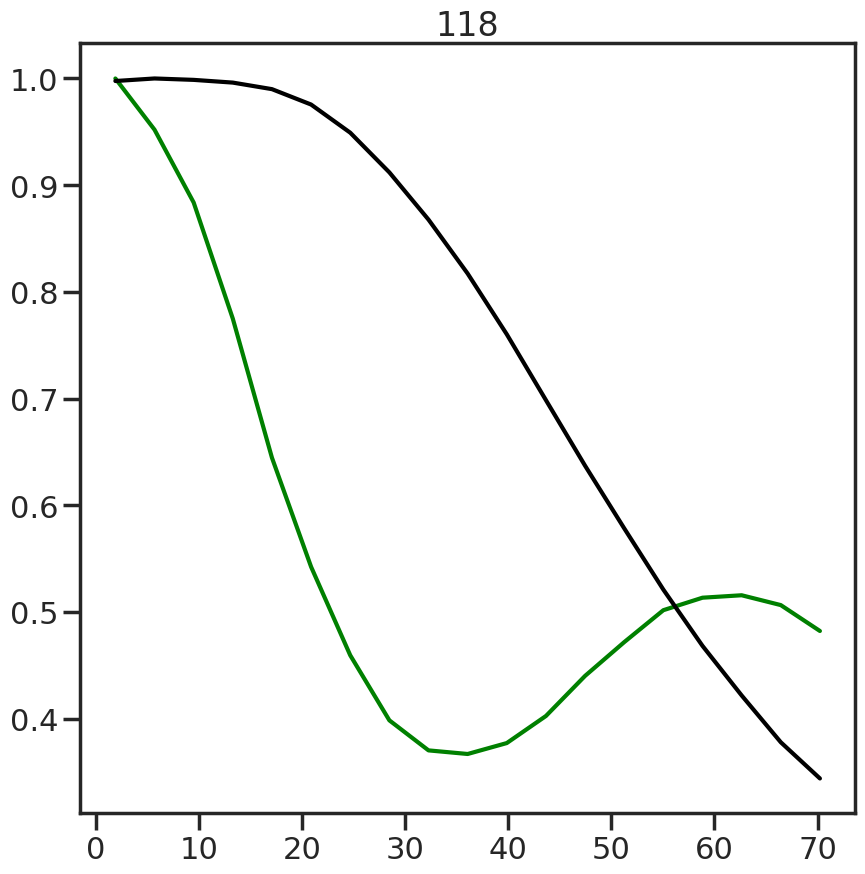

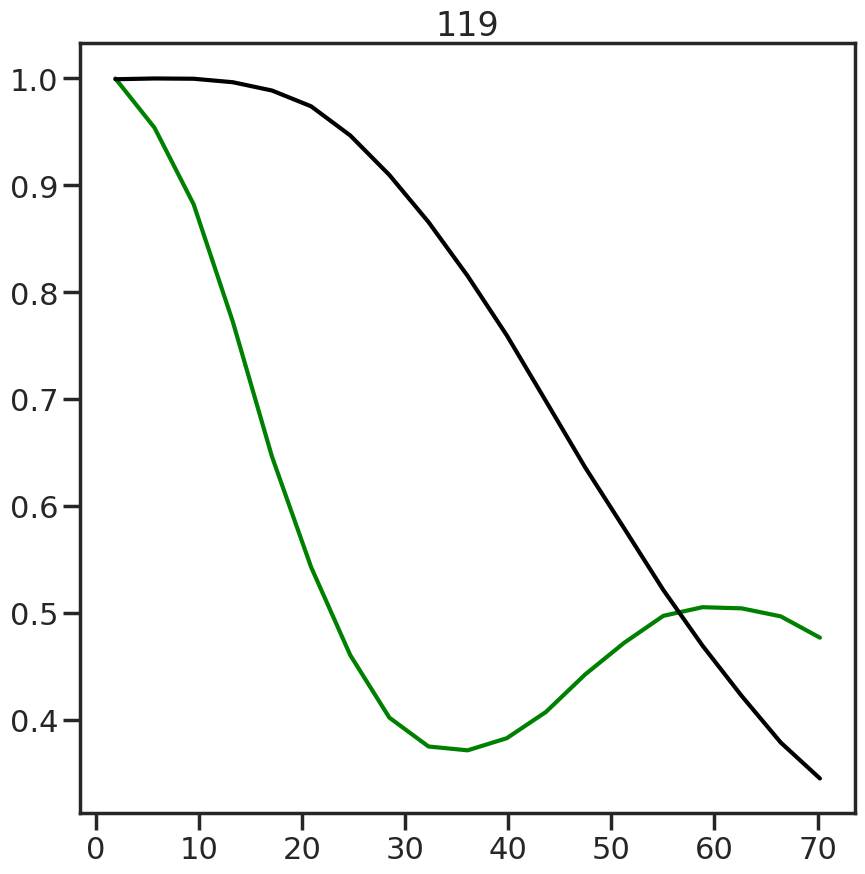

In [317]:
for z in range(120):#[10, 20, 30, 40, 50, 60, 70, 80, 90, 100]:
    fig, ax = plt.subplots(figsize=(10,10))
    zcent=z
    #radially average
    rDec, rAvgDecs=polarAverage(deconvnov2[zcent, yl:yh, xl:xh])
    plt.plot(rDec, rAvgDecs/rAvgDecs.max(), color='green')
    #plt.plot(rDec, rAvgDecs, color='green')
    rRaw, rAvgRaws=polarAverage(motStacknov2[zcent, yl:yh, xl:xh])
    plt.plot(rRaw, rAvgRaws/rAvgRaws.max(), color='k')
    #plt.plot(rRaw, rAvgRaws, color='k')
    plt.title(z)


/tmp/ipykernel_1780770/3880309921.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(10,10))


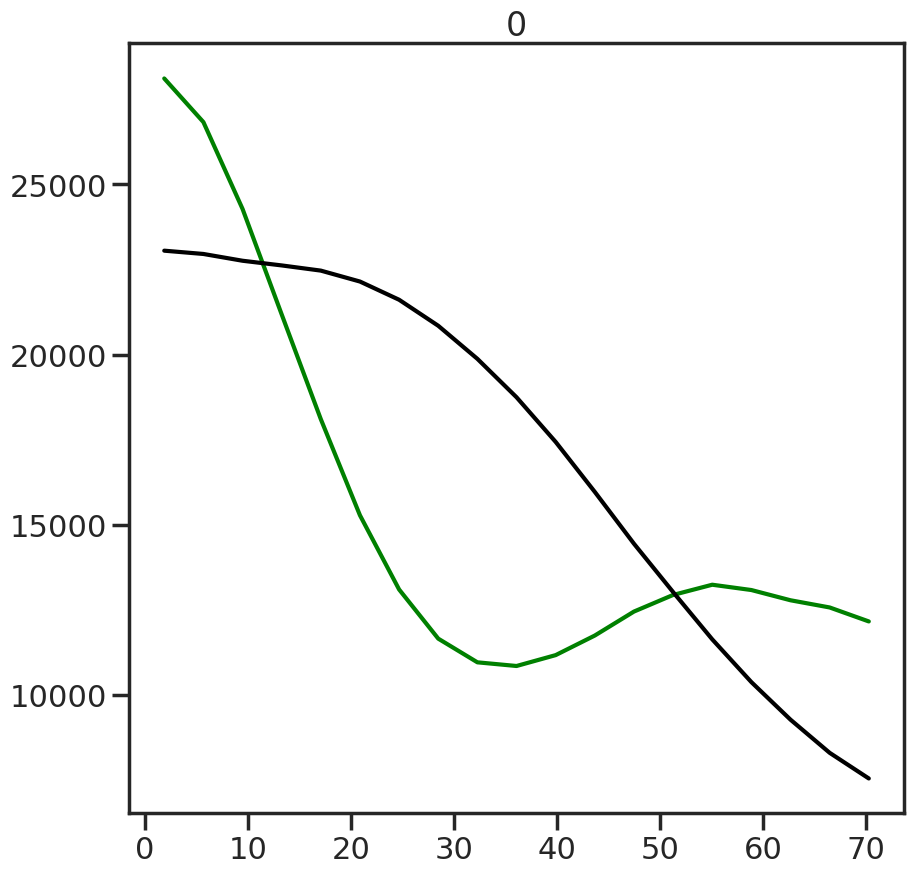

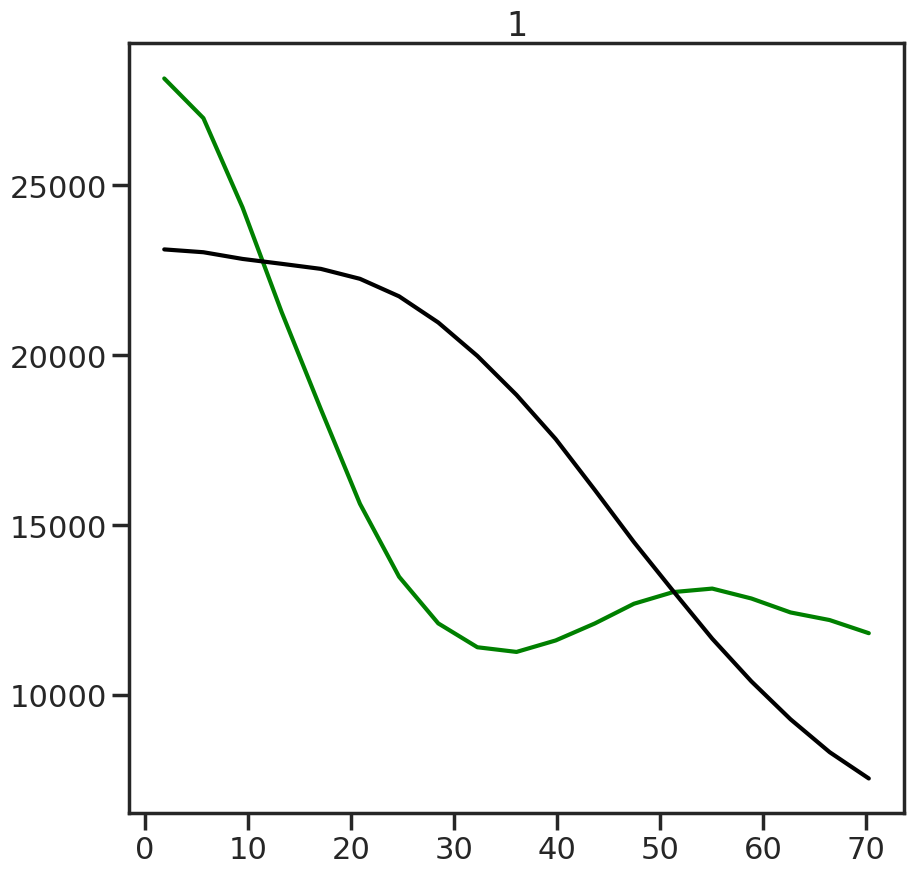

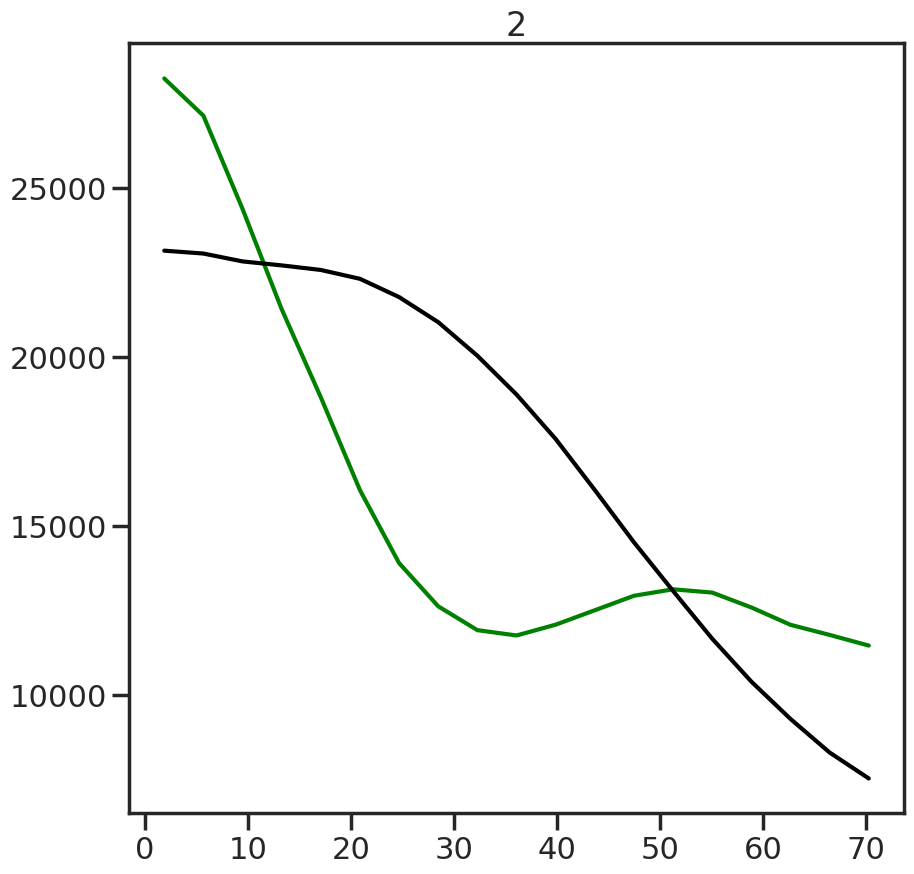

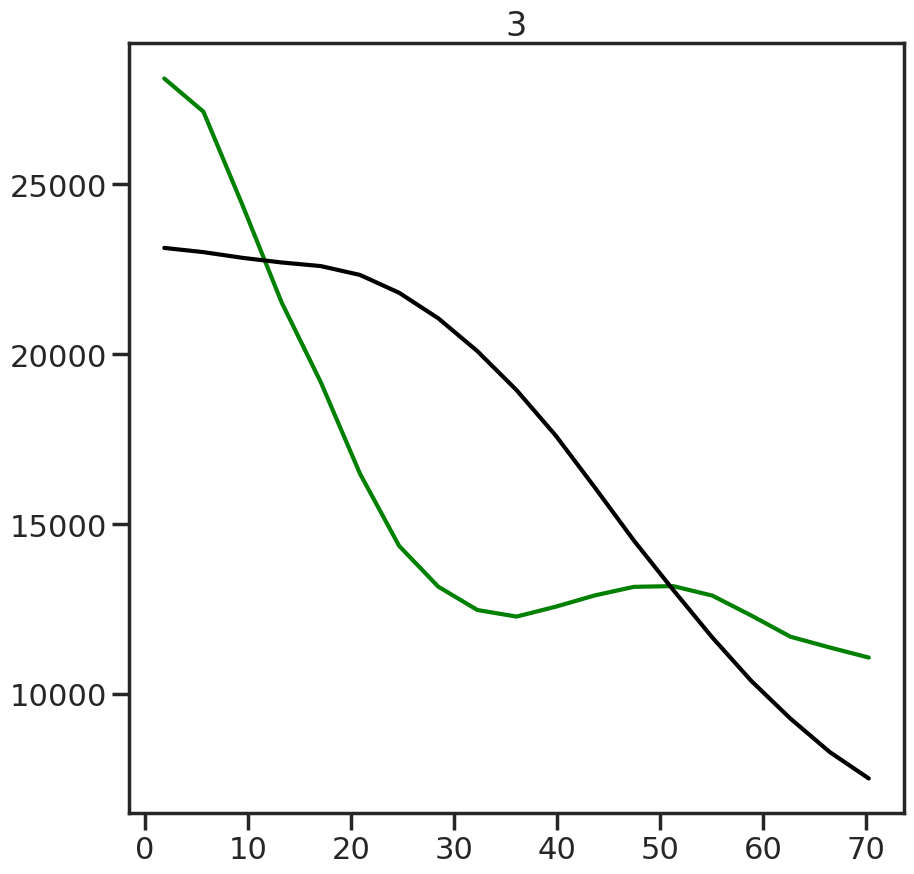

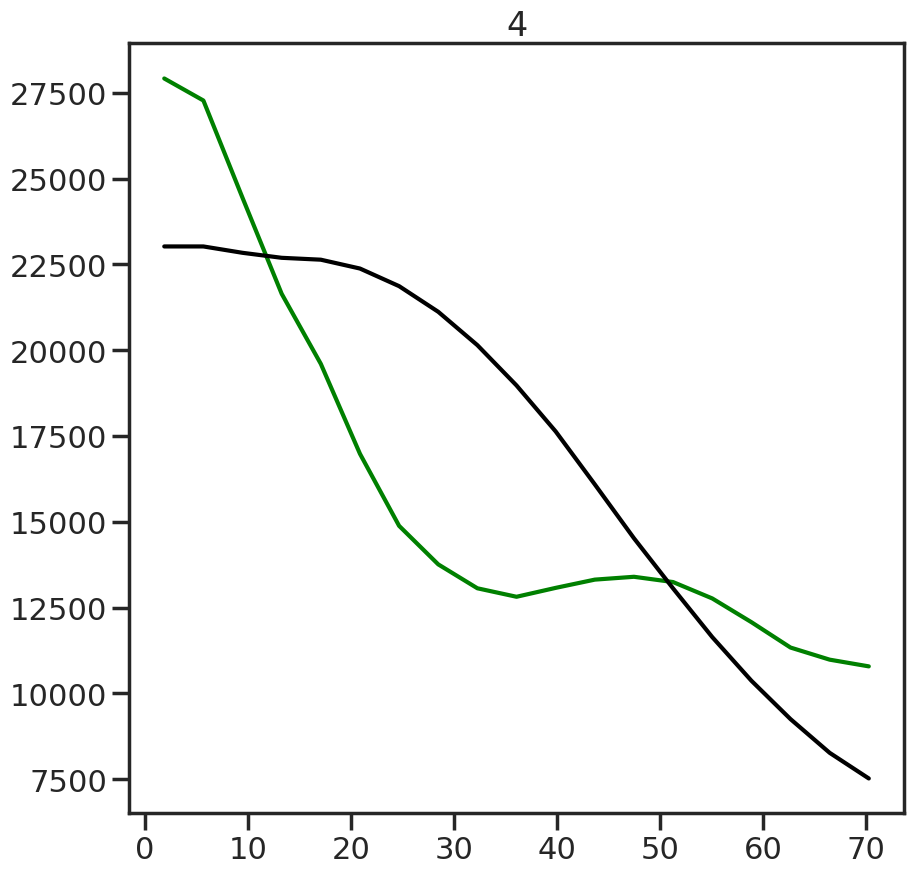

...

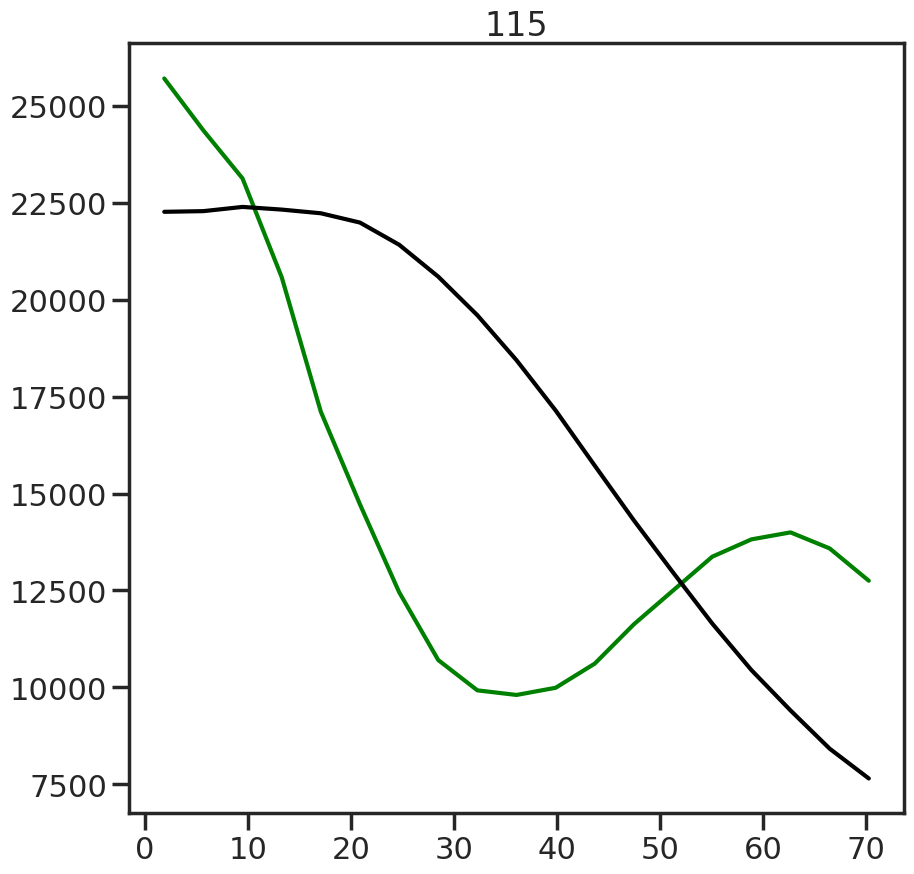

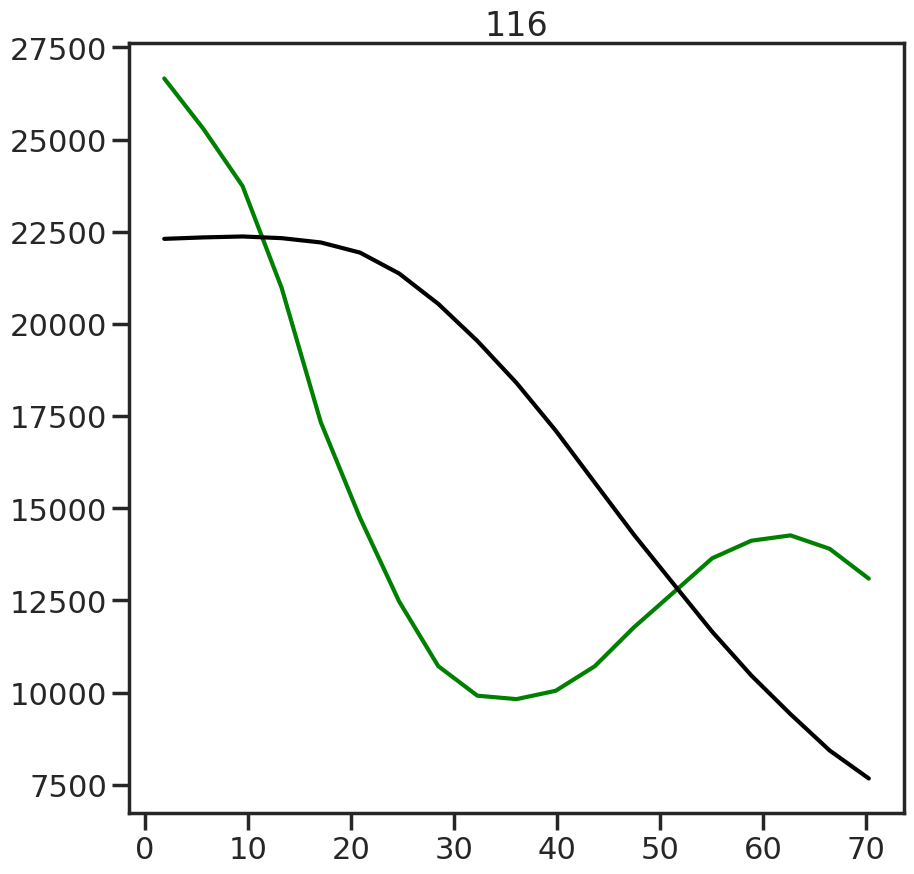

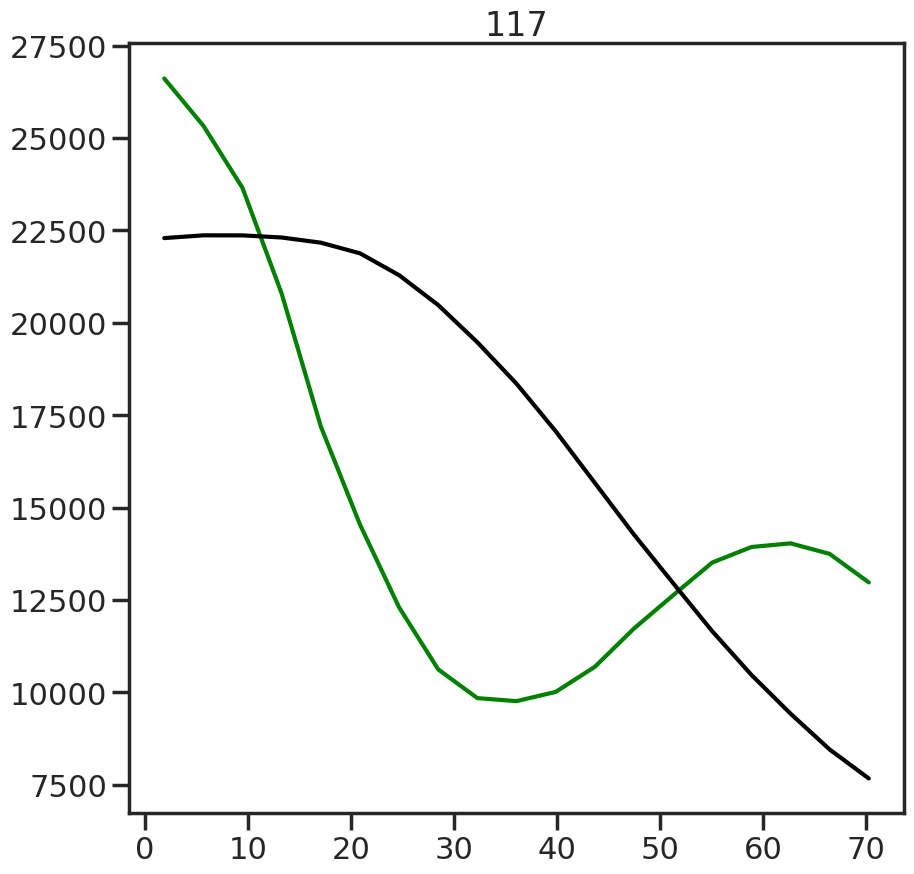

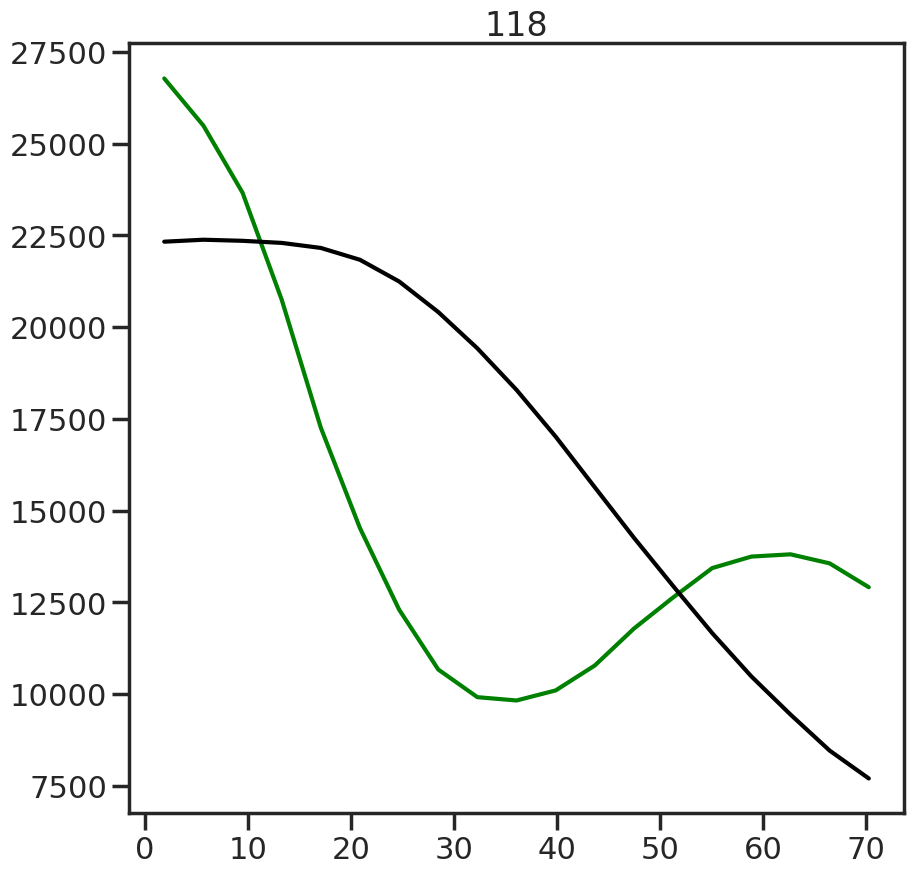

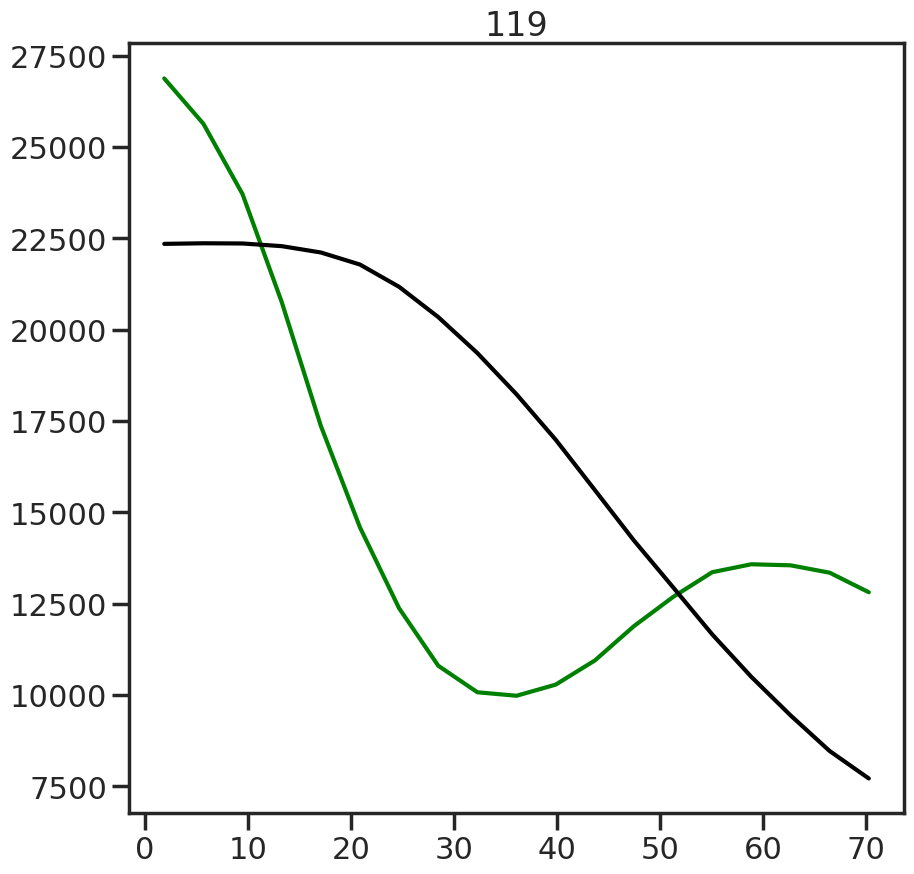

In [318]:
for z in range(120):#[10, 20, 30, 40, 50, 60, 70, 80, 90, 100]:
    fig, ax = plt.subplots(figsize=(10,10))
    zcent=z
    #radially average
    rDec, rAvgDecs=polarAverage(deconvnov2[zcent, yl:yh, xl:xh])
    #plt.plot(rDec, rAvgDecs/rAvgDecs.max(), color='green')
    plt.plot(rDec, rAvgDecs, color='green')
    rRaw, rAvgRaws=polarAverage(motStacknov2[zcent, yl:yh, xl:xh])
    #plt.plot(rRaw, rAvgRaws/rAvgRaws.max(), color='k')
    
    plt.plot(rRaw, rAvgRaws, color='k')
    plt.title(z)


# Synthetic Data

In [342]:
def gaussPSF_tot(dx, dy, dz, sigmaTr, sigmaAx):
  return np.exp(-(dx**2+dy**2)/(2*sigmaTr**2))*np.exp(-(dz**2)/(2*sigmaAx**2)) / (np.sqrt((2*np.pi*sigmaTr**2)**2) * np.sqrt((2*np.pi*sigmaAx**2)**1))


In [343]:
#### Verify that fftconv magic increasingly resembles real object
zmin=-100
zmax=100
xmin=-100
xmax=100
ymin=-100
ymax=100
numz=301
numx=301
numy=301

xvals = np.linspace(xmin, xmax, numx)
yvals = np.linspace(ymin, ymax, numy)
zvals = np.linspace(zmin, zmax, numz)

lambdaObj=30;
sigmaTr=1.3;
sigmaAx=2.5; #mu m fixed

realObj = np.zeros((numx, numy, numz))

# make psfTr again
psf = np.zeros((numx, numy, numz))
for ii in tqdm(range(len(xvals))):
  for j in range(len(yvals)):
    for k in range(len(zvals)):
      psf[ii, j, k]= gaussPSF_tot(xvals[ii], yvals[j], zvals[k], sigmaTr, sigmaAx)

psf=psf/psf.sum()

#convedObjs=np.zeros((numx, numy, numz)); # this will store the convolutions

#realObjList=[];
for ii in tqdm(range(len(xvals))):
    for j in range(len(yvals)):
      for k in range(len(zvals)):
        realObj[ii, j, k]= np.exp(-np.sqrt(xvals[ii]**2+yvals[j]**2+zvals[k]**2)/lambdaObj)

fftconv3D =  scipy.signal.convolve(realObj, psf, mode='same')

  0%|          | 0/301 [00:00<?, ?it/s]

  0%|          | 0/301 [00:00<?, ?it/s]